<p style="align: center;"><img align=center src="https://drive.google.com/uc?export=view&id=1I8kDikouqpH4hf7JBiSYAeNT2IO52T-T" width=600 height=480/></p>
<h3 style="text-align: center;"><b>Школа глубокого обучения ФПМИ МФТИ</b></h3>

<h3 style="text-align: center;"><b>Домашнее задание. Сегментация изображений</b></h3>


В этом задании вам предстоит решить задачу сегментации медицинских снимков. Часть кода с загрузкой данных написана за вас. Всю содержательную сторону вопроса вам нужно заполнить самостоятельно. Задание оценивается из 15 баллов. 

Обратите внимание, что отчёт по заданию стоит целых 6 баллов. Он вынесен в отдельный пункт в конце тетради. Это сделано для того, чтобы тетрадь была оформлена как законченный документ о проведении экспериментов. Неотъемлемой составляющей отчёта является ответ на следующие вопросы:

* Что было сделано? Что получилось реализовать, что не получилось?
* Какие результаты ожидалось получить?
* Какие результаты были достигнуты?
* Чем результаты различных подходов отличались друг от друга и от бейзлайна (если таковой присутствует)?




# Imports

In [2]:
!pip install googledrivedownloader

In [3]:
!pip install torchinfo

In [4]:
import os
import pickle
import random
import time

import matplotlib.pyplot as plt
import numpy as np
import pandas as pd
from matplotlib import rcParams

import torch
import torch.nn as nn
import torch.nn.functional as F
import torch.optim as optim
from torch.utils.data import DataLoader
from torchvision import models

from tqdm.notebook import tqdm, trange

from torchinfo import summary

from google_drive_downloader import GoogleDriveDownloader as gdd

from IPython.display import clear_output

from skimage.io import imread
from skimage.transform import resize

# Setting random seeds for reproducibility

In [4]:
RANDOM_STATE = 42
random.seed(RANDOM_STATE)
os.environ['PYTHONHASHSEED'] = str(RANDOM_STATE)
np.random.seed(RANDOM_STATE)
torch.manual_seed(RANDOM_STATE)
torch.cuda.manual_seed(RANDOM_STATE)
torch.cuda.manual_seed_all(RANDOM_STATE)
# not enabling deterministic mode since this breaks half of pytorch.

# Downloading and preparing data

---


1. Для начала мы скачаем датасет: [ADDI project](https://www.fc.up.pt/addi/ph2%20database.html).

<table><tr><td>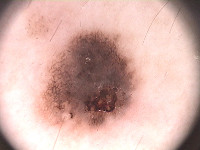</td><td>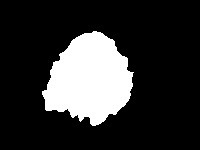</td></tr></table>

2. Разархивируем .rar файл.
3. Обратите внимание, что папка  `PH2 Dataset images` должна лежать там же где и ipynb notebook.

Это фотографии двух типов **поражений кожи:** меланома и родинки.
В данном задании мы не будем заниматься их классификацией, а будем **сегментировать** их.

## Downloading and unpacking data

In [5]:
gdd.download_file_from_google_drive(file_id='1VtEDXKLJSe0-x3RnQvlvZZv9bqKMte0h',
                                    dest_path='./PH2Dataset.rar',
                                    unzip=False)

In [6]:
get_ipython().system_raw("unrar x PH2Dataset.rar")

## Loading data

Стуктура датасета у нас следующая:

    IMD_002/
        IMD002_Dermoscopic_Image/
            IMD002.bmp
        IMD002_lesion/
            IMD002_lesion.bmp
        IMD002_roi/
            ...
    IMD_003/
        ...
        ...

 Здесь `X.bmp` — изображение, которое нужно сегментировать, `X_lesion.bmp` — результат сегментации.

Для загрузки датасета можно использовать skimage: [`skimage.io.imread()`](https://scikit-image.org/docs/dev/api/skimage.io.html)

In [7]:
images = []
lesions = []
root = 'PH2Dataset'

for root, dirs, files in os.walk(os.path.join(root, 'PH2 Dataset images')):
    if root.endswith('_Dermoscopic_Image'):
        images.append(imread(os.path.join(root, files[0])))
    if root.endswith('_lesion'):
        lesions.append(imread(os.path.join(root, files[0])))

## Resizing images and casting type

Изображения имеют разные размеры. Давайте изменим их размер на $256\times256 $ пикселей. Для изменения размера изображений можно использовать [`skimage.transform.resize()`](https://scikit-image.org/docs/dev/api/skimage.transform.html#skimage.transform.resize).
Эта функция также автоматически нормализует изображения в диапазоне $[0,1]$.


In [8]:
size = (256, 256)
X = [resize(x, size, mode='constant', anti_aliasing=True,) for x in images]
Y = [resize(y, size, mode='constant', anti_aliasing=False) > 0.5 for y in lesions]

In [9]:
X = np.array(X, np.float32)
Y = np.array(Y, np.float32)
print(f'Loaded {len(X)} images')

Loaded 200 images


In [10]:
len(lesions)

200

## Looking at the data

Чтобы убедиться, что все корректно, мы нарисуем несколько изображений

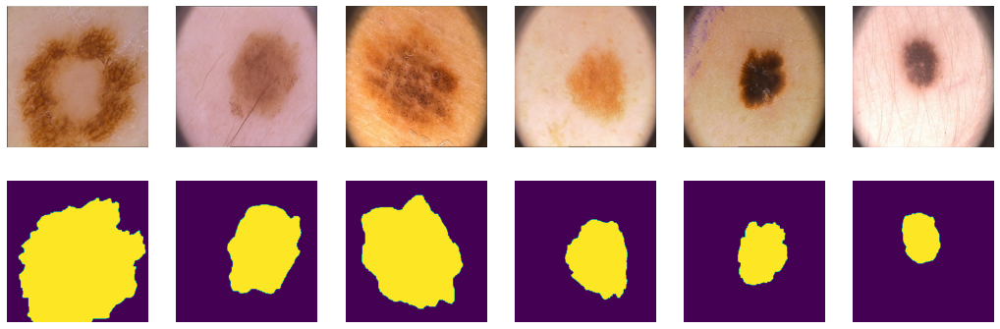

In [11]:
plt.figure(figsize=(18, 6))
for i in range(6):
    plt.subplot(2, 6, i+1)
    plt.axis("off")
    plt.imshow(X[i])

    plt.subplot(2, 6, i+7)
    plt.axis("off")
    plt.imshow(Y[i])
plt.show();

## Train/Val/Test splitting

Разделим наши 200 картинок на 100/50/50
 для обучения, валидации и теста соответственно

In [12]:
ix = np.random.choice(len(X), len(X), False)
tr, val, ts = np.split(ix, [100, 150])

In [13]:
print(len(tr), len(val), len(ts))

100 50 50


## Preparing dataloaders

In [14]:
batch_size = 25
data_tr = DataLoader(list(zip(np.rollaxis(X[tr], 3, 1), Y[tr, np.newaxis])), 
                     batch_size=batch_size, shuffle=True, num_workers=torch.multiprocessing.cpu_count())
data_val = DataLoader(list(zip(np.rollaxis(X[val], 3, 1), Y[val, np.newaxis])),
                      batch_size=batch_size, shuffle=False, num_workers=torch.multiprocessing.cpu_count())
data_ts = DataLoader(list(zip(np.rollaxis(X[ts], 3, 1), Y[ts, np.newaxis])),
                     batch_size=batch_size, shuffle=False, num_workers=torch.multiprocessing.cpu_count())

# Checking CUDA availability

In [15]:
device = torch.device('cuda' if torch.cuda.is_available() else 'cpu')
print(device)

cuda


In [16]:
!nvidia-smi

Fri Dec 10 21:17:55 2021       
+-----------------------------------------------------------------------------+
| NVIDIA-SMI 495.44       Driver Version: 460.32.03    CUDA Version: 11.2     |
|-------------------------------+----------------------+----------------------+
| GPU  Name        Persistence-M| Bus-Id        Disp.A | Volatile Uncorr. ECC |
| Fan  Temp  Perf  Pwr:Usage/Cap|         Memory-Usage | GPU-Util  Compute M. |
|                               |                      |               MIG M. |
|===============================+======================+======================|
|   0  Tesla K80           Off  | 00000000:00:04.0 Off |                    0 |
| N/A   51C    P8    31W / 149W |      3MiB / 11441MiB |      0%      Default |
|                               |                      |                  N/A |
+-------------------------------+----------------------+----------------------+
                                                                               
+-------

# Setting plotting params

In [17]:
rcParams['figure.figsize'] = (15,4)

# Реализация различных архитектур:
Ваше задание будет состоять в том, чтобы написать несколько нейросетевых архитектур для решения задачи семантической сегментации. Сравнить их по качеству на тесте и испробовать различные лосс функции для них.

-----------------------------------------------------------------------------------------

## SegNet [2 балла]

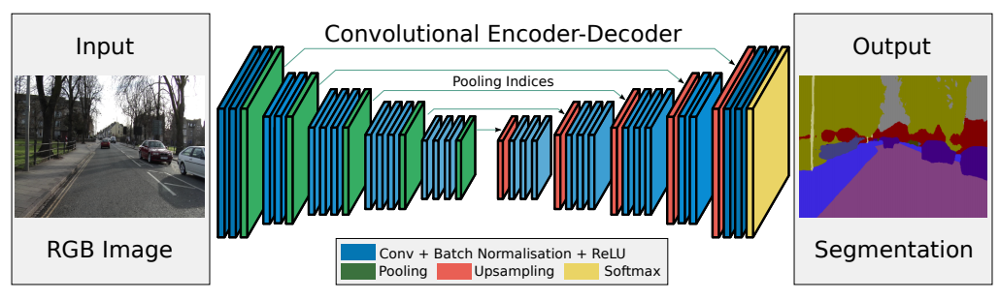

* Badrinarayanan, V., Kendall, A., & Cipolla, R. (2015). [SegNet: A deep convolutional
encoder-decoder architecture for image segmentation](https://arxiv.org/pdf/1511.00561.pdf)

Внимательно посмотрите из чего состоит модель и для чего выбраны те или иные блоки.

### Init model

In [18]:
class SegNet(nn.Module):
    def __init__(self):
        super().__init__()

        # encoder (downsampling)
        # Each enc_conv/dec_conv block should look like this:
        # nn.Sequential(
        #     nn.Conv2d(...),
        #     ... (2 or 3 conv layers with relu and batchnorm),
        # )
        self.enc_conv0 = nn.Sequential(
            nn.Conv2d(in_channels=3, out_channels=32, kernel_size=3, stride=1, padding=1),
            nn.BatchNorm2d(32),
            nn.ReLU(inplace=True),

            nn.Conv2d(in_channels=32, out_channels=32, kernel_size=3, stride=1, padding=1),
            nn.BatchNorm2d(32),
            nn.ReLU(inplace=True)
        )

        self.pool0 = nn.MaxPool2d(kernel_size=2, stride=2, return_indices=True)  # 256 -> 128

        self.enc_conv1 = nn.Sequential(
            nn.Conv2d(in_channels=32, out_channels=64, kernel_size=3, stride=1, padding=1),
            nn.BatchNorm2d(64),
            nn.ReLU(inplace=True),

            nn.Conv2d(in_channels=64, out_channels=64, kernel_size=3, stride=1, padding=1),
            nn.BatchNorm2d(64),
            nn.ReLU(inplace=True)
        )

        self.pool1 = nn.MaxPool2d(kernel_size=2, stride=2, return_indices=True) # 128 -> 64

        self.enc_conv2 = nn.Sequential(
            nn.Conv2d(in_channels=64, out_channels=128, kernel_size=3, stride=1, padding=1),
            nn.BatchNorm2d(128),
            nn.ReLU(inplace=True),

            nn.Conv2d(in_channels=128, out_channels=128, kernel_size=3, stride=1, padding=1),
            nn.BatchNorm2d(128),
            nn.ReLU(inplace=True),

            nn.Conv2d(in_channels=128, out_channels=128, kernel_size=3, stride=1, padding=1),
            nn.BatchNorm2d(128),
            nn.ReLU(inplace=True),
        )

        self.pool2 = nn.MaxPool2d(kernel_size=2, stride=2, return_indices=True) # 64 -> 32

        self.enc_conv3 = nn.Sequential(
            nn.Conv2d(in_channels=128, out_channels=256, kernel_size=3, stride=1, padding=1),
            nn.BatchNorm2d(256),
            nn.ReLU(inplace=True),
        
            nn.Conv2d(in_channels=256, out_channels=256, kernel_size=3, stride=1, padding=1),
            nn.BatchNorm2d(256),
            nn.ReLU(inplace=True),
        
            nn.Conv2d(in_channels=256, out_channels=256, kernel_size=3, stride=1, padding=1),
            nn.BatchNorm2d(256),
            nn.ReLU(inplace=True),
        )

        self.pool3 = nn.MaxPool2d(kernel_size=2, stride=2, return_indices=True) # 32 -> 16

        # bottleneck
        self.bottleneck_downconv = nn.Sequential(
            nn.Conv2d(in_channels=256, out_channels=256, kernel_size=3, stride=1, padding=1),
            nn.BatchNorm2d(256),
            nn.ReLU(inplace=True),
        
            nn.Conv2d(in_channels=256, out_channels=256, kernel_size=3, stride=1, padding=1),
            nn.BatchNorm2d(256),
            nn.ReLU(inplace=True),
        
            nn.Conv2d(in_channels=256, out_channels=256, kernel_size=3, stride=1, padding=1),
            nn.BatchNorm2d(256),
            nn.ReLU(inplace=True),
        )

        self.bottleneck_downsample = nn.MaxPool2d(kernel_size=2, stride=2, return_indices=True)

        self.bottleneck_upsample = nn.MaxUnpool2d(kernel_size=2, stride=2)

        self.bottleneck_upconv = nn.Sequential(
            nn.Conv2d(in_channels=256, out_channels=256, kernel_size=3, stride=1, padding=1),
            nn.BatchNorm2d(256),
            nn.ReLU(inplace=True),
        
            nn.Conv2d(in_channels=256, out_channels=256, kernel_size=3, stride=1, padding=1),
            nn.BatchNorm2d(256),
            nn.ReLU(inplace=True),
        
            nn.Conv2d(in_channels=256, out_channels=256, kernel_size=3, stride=1, padding=1),
            nn.BatchNorm2d(256),
            nn.ReLU(inplace=True),
        )

        # decoder (upsampling)
        self.upsample0 = nn.MaxUnpool2d(kernel_size=2, stride=2) # 16 -> 32
        self.dec_conv0 = nn.Sequential(
            nn.Conv2d(in_channels=256, out_channels=256, kernel_size=3, stride=1, padding=1),
            nn.BatchNorm2d(256),
            nn.ReLU(inplace=True),
        
            nn.Conv2d(in_channels=256, out_channels=256, kernel_size=3, stride=1, padding=1),
            nn.BatchNorm2d(256),
            nn.ReLU(inplace=True),
        
            nn.Conv2d(in_channels=256, out_channels=128, kernel_size=3, stride=1, padding=1),
            nn.BatchNorm2d(128),
            nn.ReLU(inplace=True),
        )
        self.upsample1 = nn.MaxUnpool2d(kernel_size=2, stride=2) # 32 -> 64
        self.dec_conv1 = nn.Sequential(
            nn.Conv2d(in_channels=128, out_channels=128, kernel_size=3, stride=1, padding=1),
            nn.BatchNorm2d(128),
            nn.ReLU(inplace=True),
        
            nn.Conv2d(in_channels=128, out_channels=128, kernel_size=3, stride=1, padding=1),
            nn.BatchNorm2d(128),
            nn.ReLU(inplace=True),
        
            nn.Conv2d(in_channels=128, out_channels=64, kernel_size=3, stride=1, padding=1),
            nn.BatchNorm2d(64),
            nn.ReLU(inplace=True),
        )
        self.upsample2 = nn.MaxUnpool2d(kernel_size=2, stride=2)  # 64 -> 128
        self.dec_conv2 = nn.Sequential(
            nn.Conv2d(in_channels=64, out_channels=64, kernel_size=3, stride=1, padding=1),
            nn.BatchNorm2d(64),
            nn.ReLU(inplace=True),
        
            nn.Conv2d(in_channels=64, out_channels=32, kernel_size=3, stride=1, padding=1),
            nn.BatchNorm2d(32),
            nn.ReLU(inplace=True)
        )
        self.upsample3 = nn.MaxUnpool2d(kernel_size=2, stride=2)  # 128 -> 256
        self.dec_conv3 = nn.Sequential(
            nn.Conv2d(in_channels=32, out_channels=32, kernel_size=3, stride=1, padding=1),
            nn.BatchNorm2d(32),
            nn.ReLU(inplace=True),
        
            nn.Conv2d(in_channels=32, out_channels=1, kernel_size=3, stride=1, padding=1),
            nn.BatchNorm2d(1),
            nn.ReLU(inplace=True)
        )

    def forward(self, x):
        # encoder
        e0, pool_idx0 = self.pool0(self.enc_conv0(x))
        e1, pool_idx1 = self.pool1(self.enc_conv1(e0))
        e2, pool_idx2 = self.pool2(self.enc_conv2(e1))
        e3, pool_idx3 = self.pool3(self.enc_conv3(e2))

        # bottleneck
        b, b_idx = self.bottleneck_downsample(self.bottleneck_downconv(e3))
        b = self.bottleneck_upconv(self.bottleneck_upsample(b, b_idx))

        # decoder
        d0 = self.dec_conv0(self.upsample0(b, pool_idx3))
        d1 = self.dec_conv1(self.upsample1(d0, pool_idx2))
        d2 = self.dec_conv2(self.upsample2(d1, pool_idx1))
        d3 = self.dec_conv3(self.upsample3(d2, pool_idx0)) # no activation
        return d3

## Метрика

В данном разделе предлагается использовать следующую метрику для оценки качества:

$I o U=\frac{\text {target } \cap \text { prediction }}{\text {target } \cup{prediction }}$

Пересечение (A ∩ B) состоит из пикселей, найденных как в маске предсказания, так и в основной маске истины, тогда как объединение (A ∪ B) просто состоит из всех пикселей, найденных либо в маске предсказания, либо в целевой маске.


Для примера посмотрим на истину (слева) и предсказание (справа):
![alt text](https://www.jeremyjordan.me/content/images/2018/05/target_prediction.png)


Тогда пересечение и объединение будет выглядеть так:

![alt text](https://www.jeremyjordan.me/content/images/2018/05/intersection_union.png)

In [19]:
def iou_pytorch(outputs: torch.Tensor, labels: torch.Tensor):
    # You can comment out this line if you are passing tensors of equal shape
    # But if you are passing output from UNet or something it will most probably
    # be with the BATCH x 1 x H x W shape
    outputs = outputs.squeeze(1).byte()  # BATCH x 1 x H x W => BATCH x H x W
    labels = labels.squeeze(1).byte()
    SMOOTH = 1e-8
    intersection = (outputs & labels).float().sum((1, 2))  # Will be zero if Truth=0 or Prediction=0
    union = (outputs | labels).float().sum((1, 2))         # Will be zzero if both are 0
    
    iou = (intersection + SMOOTH) / (union + SMOOTH)  # We smooth our devision to avoid 0/0

    #return iou
    
    thresholded = torch.clamp(20 * (iou - 0.5), 0, 10).ceil() / 10  # This is equal to comparing with thresolds
    
    return thresholded

## Функция потерь [1 балл]

Не менее важным, чем построение архитектуры, является определение **оптимизатора** и **функции потерь.**

Функция потерь - это то, что мы пытаемся минимизировать. Многие из них могут быть использованы для задачи бинарной семантической сегментации. 

Популярным методом для бинарной сегментации является *бинарная кросс-энтропия*, которая задается следующим образом:

$$\mathcal L_{BCE}(y, \hat y) = -\sum_i \left[y_i\log\sigma(\hat y_i) + (1-y_i)\log(1-\sigma(\hat y_i))\right].$$

где $y$ это  таргет желаемого результата и $\hat y$ является выходом модели. $\sigma$ - это [*логистическая* функция](https://en.wikipedia.org/wiki/Sigmoid_function), который преобразует действительное число $\mathbb R$ в вероятность $[0,1]$.

Однако эта потеря страдает от проблем численной нестабильности. Самое главное, что $\lim_{x\rightarrow0}\log(x)=\infty$ приводит к неустойчивости в процессе оптимизации. Рекомендуется посмотреть следующее [упрощение](https://www.tensorflow.org/api_docs/python/tf/nn/sigmoid_cross_entropy_with_logits). Эта функция эквивалентна первой и не так подвержена численной неустойчивости:

$$\mathcal L_{BCE} = \hat y - y\hat y + \log\left(1+\exp(-\hat y)\right).$$

In [20]:
def bce_loss(y_pred, y_real, reduction="mean"):
  loss = (y_pred - y_real * y_pred + torch.log(1. + torch.exp(-1. * y_pred)))
  if reduction == "none":
    return loss
  elif reduction == "sum":
    return loss.sum()
  elif reduction == "mean":
    return loss.mean()
  else:
    raise ValueError("Undefined reduction: must be either \"none\", \"sum\" or \"mean\"")

## Тренировка [1 балл]

Мы определим цикл обучения в функции, чтобы мы могли повторно использовать его.

In [21]:
def save_model(path, model, optimizer, criterion, epoch, history):
  torch.save({
  "epoch": epoch,
  "model_state_dict": model.state_dict(),
  "optimizer_state_dict": optimizer.state_dict(),
  "loss": criterion,
  "history": history},
  path)

In [22]:
def fit_epoch(model, optimizer, criterion, train_loader):
  model.train()
  running_loss = 0.0
  processed_data = 0

  for inputs, labels in tqdm(train_loader, desc="Fitting"):
    try:
      inputs = inputs.to(device)
      labels = labels.to(device)
      optimizer.zero_grad()
      outputs = model(inputs)
      loss = criterion(outputs, labels)
      loss.backward()
      optimizer.step()
      running_loss += loss.item() * inputs.size(0)
      processed_data += inputs.size(0)

      # clearing VRAM
      inputs = inputs.to("cpu")
      labels = labels.to("cpu")
      del inputs
      del labels
      torch.cuda.empty_cache()
    except Exception as e:
      # clearing VRAM
      inputs = inputs.to("cpu")
      labels = labels.to("cpu")
      del inputs
      del labels
      torch.cuda.empty_cache()
      raise e
  train_loss = running_loss / processed_data
  return train_loss, score_model(model, iou_pytorch, train_loader)

In [23]:
def eval_epoch(model, val_loader, criterion):
    model.eval()
    running_loss = 0.0
    processed_data = 0

    for inputs, labels in tqdm(val_loader, desc="Validating"):
      try:
        inputs = inputs.to(device)
        labels = labels.to(device)

        with torch.no_grad():
            outputs = model(inputs)
            loss = criterion(outputs, labels)

        running_loss += loss.item() * inputs.size(0)
        processed_data += inputs.size(0)

        # clearing VRAM
        inputs = inputs.to("cpu")
        labels = labels.to("cpu")
        del inputs
        del labels
        torch.cuda.empty_cache()
      except Exception as e:
        # clearing VRAM
        inputs = inputs.to("cpu")
        labels = labels.to("cpu")
        del inputs
        del labels
        torch.cuda.empty_cache()
        raise e
    val_loss = running_loss / processed_data
    return outputs, val_loss, score_model(model, iou_pytorch, val_loader)

In [24]:
def show_pics(val_loader, outputs, model, epoch, val_loss):
  X_val, Y_val = next(iter(val_loader))
  Y_hat = torch.sigmoid(model(X_val.to(device))).round().detach().cpu()
  for k in range(6):
    plt.subplot(3, 6, k+1)
    plt.imshow(np.rollaxis(X_val[k].numpy(), 0, 3), cmap="gray")
    plt.title("Real")
    plt.axis("off")

    plt.subplot(3, 6, k+7)
    plt.imshow(Y_val.numpy()[k, 0], cmap="gray")
    plt.title("Ground-truth")
    plt.axis("off")

    plt.subplot(3, 6, k+13)
    plt.imshow(Y_hat[k, 0], cmap="gray")
    plt.title("Output")
    plt.axis("off")
  plt.suptitle("Epoch %d, loss: %f" % (epoch + 1, val_loss))
  plt.show()
  X_val = X_val.to("cpu")
  del X_val
  torch.cuda.empty_cache()

In [25]:
def train(train_loader, val_loader, model, optimizer, criterion, epochs, batch_size, scheduler=None, start_epoch=0):

  history = []
  log_template = "\nEpoch {ep:03d} train_loss: {t_loss:0.4f} \
  val_loss {v_loss:0.4f} train_iou {t_iou:0.4f} val_iou {v_iou:0.4f}"

  prev_lr = optimizer.param_groups[0]["lr"]

  start_time = time.time()

  with tqdm(desc="Epoch", total=epochs) as pbar_outer:
      for epoch in range(start_epoch, epochs):
        train_loss, train_iou = fit_epoch(model, optimizer, criterion, train_loader)
        tqdm.write(f"loss: {train_loss}")

        outputs, val_loss, val_iou = eval_epoch(model, val_loader, criterion)

        clear_output(wait=True)
        pbar_outer.update(1)
        tqdm.write(log_template.format(ep=epoch+1, t_loss=train_loss,\
                                           v_loss=val_loss, t_iou=train_iou, v_iou=val_iou))
        if scheduler is not None:
          scheduler.step(val_loss)

        history.append((train_loss, train_iou, val_loss, val_iou, optimizer.param_groups[0]["lr"]))

        if epoch > 2 and history[-2][-1] > history[-1][-1]:
          tqdm.write("Reducing learn rate.")
        
        show_pics(val_loader, outputs, model, epoch, val_loss)

        pbar_outer.refresh()

    
  
  end_time = time.time()
  train_times.append(end_time - start_time)

  return history

## Инференс [1 балл]

После обучения модели эту функцию можно использовать для прогнозирования сегментации на новых данных:

In [26]:
def score_model(model, metric, data):
    model.eval()  # testing mode
    scores = 0
    for X_batch, Y_label in tqdm(data, desc="Scoring"):
      try:
        X_batch = X_batch.to(device)
        Y_label = Y_label.to(device)
        Y_pred = torch.sigmoid(model(X_batch)).round()
        scores += metric(Y_pred, Y_label).mean().item()

        X_batch = X_batch.to("cpu")
        Y_label = Y_label.to("cpu")
        del X_batch
        del Y_label
        torch.cuda.empty_cache()
      except Exception as e:
        X_batch = X_batch.to("cpu")
        Y_label = Y_label.to("cpu")
        del X_batch
        del Y_label
        torch.cuda.empty_cache()

    return scores / len(data)

In [27]:
def predict(model, data):
    model.eval()  # testing mode
    with torch.no_grad():
      preds = []
      for X_batch, y_label in tqdm(data, desc="Inferring"):
        try:
          inputs = inputs.to(device)
          outputs = torch.sigmoid(model(inputs)).round().detach().cpu()
          preds.append(outputs)
          inputs = inputs.to("cpu")
          del inputs
          torch.cuda.empty_cache()
        except Exception as e:
          inputs = inputs.to("cpu")
          del inputs
          torch.cuda.empty_cache()

    return preds

In [28]:
def plot_loss(history):
  loss, _, val_loss, _, _ = zip(*history)
  plt.figure(figsize=(15, 9))
  plt.plot(loss, label="Train loss")
  plt.plot(val_loss, label="Validation loss")
  plt.legend(loc="best")
  plt.xlabel("Epochs")
  plt.ylabel("Loss")
  plt.show()

In [29]:
def plot_metrics(history):
  _, train_metric, _, val_metric, _ = zip(*history)
  plt.figure(figsize=(15, 9))
  plt.plot(train_metric, label="Train IoU")
  plt.plot(val_metric, label="Validation IoU")
  plt.legend(loc="best")
  plt.xlabel("Epochs")
  plt.ylabel("Score")
  plt.show()

In [30]:
def plot_learn_rate(history):
  _, _, _, _, learn_rates = zip(*history)
  plt.figure(figsize=(15, 9))
  plt.plot(learn_rates, label="Learn rate")
  plt.legend(loc="best")
  plt.xlabel("Epochs")
  plt.ylabel("Learn rate")
  plt.show()

In [31]:
def load_model(path, model_arch, optim_class, optim_kwargs):
  model = model_arch()
  checkpoint = torch.load(path)
  model.load_state_dict(checkpoint["model_state_dict"])
  optim = optim_class(model.parameters(), **optim_kwargs)
  optim.load_state_dict(checkpoint["optim_state_dict"])
  epoch = checkpoint["epoch"]
  loss = checkpoint["loss"]
  history = checkpoint["history"]
  model.eval()
  return model, optim, epoch, loss, history

In [32]:
def save_history(path, history):
  with open(path, "wb") as f:
    pickle.dump(history, f)

In [33]:
def load_history(path):
  with open(path, "rb") as f:
    history = pickle.load(f)
  
  return history

## Основной момент: обучение

Обучите вашу модель. Обратите внимание, что обучать необходимо до сходимости. Если указанного количества эпох (20) не хватило, попробуйте изменять количество эпох до сходимости алгоритма. Сходимость определяйте по изменению функции потерь на валидационной выборке.
 С параметрами оптимизатора можно спокойно играть, пока вы не найдете лучший вариант для себя.


In [34]:
test_scores, train_times = [], []

In [35]:
model = SegNet().to(device)

In [36]:
!nvidia-smi

Fri Dec 10 21:18:05 2021       
+-----------------------------------------------------------------------------+
| NVIDIA-SMI 495.44       Driver Version: 460.32.03    CUDA Version: 11.2     |
|-------------------------------+----------------------+----------------------+
| GPU  Name        Persistence-M| Bus-Id        Disp.A | Volatile Uncorr. ECC |
| Fan  Temp  Perf  Pwr:Usage/Cap|         Memory-Usage | GPU-Util  Compute M. |
|                               |                      |               MIG M. |
|===============================+======================+======================|
|   0  Tesla K80           Off  | 00000000:00:04.0 Off |                    0 |
| N/A   53C    P0    72W / 149W |    559MiB / 11441MiB |      4%      Default |
|                               |                      |                  N/A |
+-------------------------------+----------------------+----------------------+
                                                                               
+-------

In [37]:
summary(model, (batch_size, 3, 256, 256))

Layer (type:depth-idx)                   Output Shape              Param #
SegNet                                   --                        --
├─Sequential: 1-1                        [25, 32, 256, 256]        --
│    └─Conv2d: 2-1                       [25, 32, 256, 256]        896
│    └─BatchNorm2d: 2-2                  [25, 32, 256, 256]        64
│    └─ReLU: 2-3                         [25, 32, 256, 256]        --
│    └─Conv2d: 2-4                       [25, 32, 256, 256]        9,248
│    └─BatchNorm2d: 2-5                  [25, 32, 256, 256]        64
│    └─ReLU: 2-6                         [25, 32, 256, 256]        --
├─MaxPool2d: 1-2                         [25, 32, 128, 128]        --
├─Sequential: 1-3                        [25, 64, 128, 128]        --
│    └─Conv2d: 2-7                       [25, 64, 128, 128]        18,496
│    └─BatchNorm2d: 2-8                  [25, 64, 128, 128]        128
│    └─ReLU: 2-9                         [25, 64, 128, 128]        --
│    └

In [38]:
max_epochs = 60
optim = torch.optim.AdamW(model.parameters(), lr=1e-4)


Epoch 060 train_loss: 0.5480   val_loss 0.5549 train_iou 0.9240 val_iou 0.7700


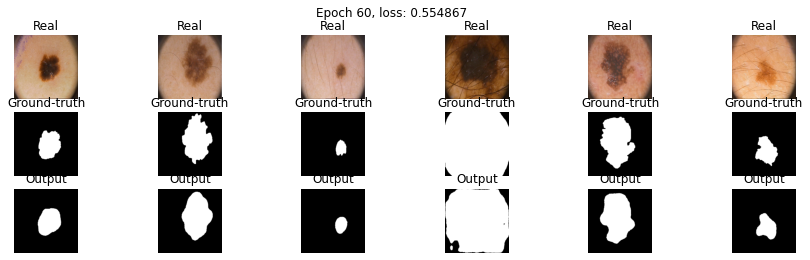

In [39]:
history_segnet_bce = train(data_tr, data_val, model, optim, bce_loss, max_epochs, batch_size)

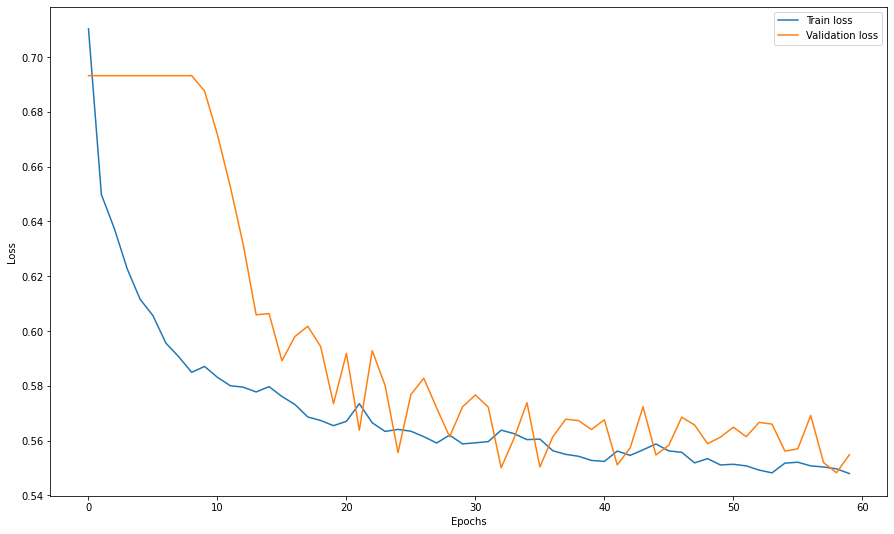

In [40]:
plot_loss(history_segnet_bce)

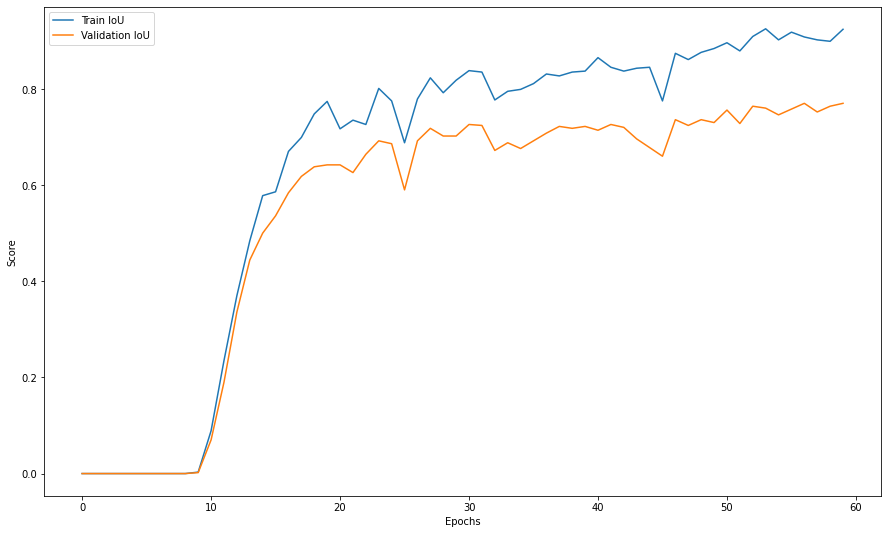

In [41]:
plot_metrics(history_segnet_bce)

In [42]:
score_segnet_bce = score_model(model, iou_pytorch, data_ts)
test_scores.append(score_segnet_bce)
score_segnet_bce

Scoring:   0%|          | 0/2 [00:00<?, ?it/s]

0.7520000338554382

In [43]:
#save_model(f"/content/segnet_bce_{max_epochs}.tar", model, optim, bce_loss, max_epochs, history_segnet_bce)

In [44]:
save_history(f"/content/history_segnet_bce.pickle", history_segnet_bce)

In [45]:
model = model.to("cpu")
del model
torch.cuda.empty_cache()

-----------------------------------------------------------------------------------------

## Дополнительные функции потерь [2 балла] 

 В данном разделе вам потребуется имплементировать две функции потерь:
 DICE и Focal loss. 
 Если у вас что-то не учится, велика вероятность, что вы ошиблись или учите слишком мало эпох, прежде чем бить тревогу попробуйте перебрать различные варианты и убедитесь, что во всех других сетапах сеть достигает желанного результата. СПОЙЛЕР: учиться она будет при всех лоссах, предложенных в этом задании.


### Dice loss

**1. Dice coefficient:** Учитывая две маски $X$ и $Y$, общая метрика для измерения расстояния между этими двумя масками задается следующим образом:

$$D(X,Y)=\frac{2|X\cap Y|}{|X|+|Y|}$$

Эта функция не является дифференцируемой, но это необходимое свойство для градиентного спуска. В данном случае мы можем приблизить его с помощью:

$$\mathcal L_D(X,Y) = 1-\frac{1}{256 \times 256} \times \sum_i\frac{2X_iY_i}{X_i+Y_i}.$$

Не забудьте подумать о численной нестабильности, возникающей в математической формуле.


In [46]:
def dice_loss(y_pred, y_real):
  smooth = 1e-5
  y_pred = torch.sigmoid(y_pred).view(-1)
  y_real = y_real.view(-1)
  num = 2 * torch.sum(y_real * y_pred) + smooth
  den = torch.sum(y_real + y_pred) + smooth
  res = (1 - (num / den)).mean()
  return res

Проводим тестирование:

### Training SegNet with Dice loss

In [47]:
model_dice = SegNet().to(device)
optimizer = torch.optim.AdamW(model_dice.parameters(), lr=1e-4)

In [48]:
!nvidia-smi

Fri Dec 10 21:33:03 2021       
+-----------------------------------------------------------------------------+
| NVIDIA-SMI 495.44       Driver Version: 460.32.03    CUDA Version: 11.2     |
|-------------------------------+----------------------+----------------------+
| GPU  Name        Persistence-M| Bus-Id        Disp.A | Volatile Uncorr. ECC |
| Fan  Temp  Perf  Pwr:Usage/Cap|         Memory-Usage | GPU-Util  Compute M. |
|                               |                      |               MIG M. |
|===============================+======================+======================|
|   0  Tesla K80           Off  | 00000000:00:04.0 Off |                    0 |
| N/A   73C    P0    91W / 149W |   1200MiB / 11441MiB |      0%      Default |
|                               |                      |                  N/A |
+-------------------------------+----------------------+----------------------+
                                                                               
+-------

In [49]:
summary(model_dice, (batch_size, 3, 256, 256))

Layer (type:depth-idx)                   Output Shape              Param #
SegNet                                   --                        --
├─Sequential: 1-1                        [25, 32, 256, 256]        --
│    └─Conv2d: 2-1                       [25, 32, 256, 256]        896
│    └─BatchNorm2d: 2-2                  [25, 32, 256, 256]        64
│    └─ReLU: 2-3                         [25, 32, 256, 256]        --
│    └─Conv2d: 2-4                       [25, 32, 256, 256]        9,248
│    └─BatchNorm2d: 2-5                  [25, 32, 256, 256]        64
│    └─ReLU: 2-6                         [25, 32, 256, 256]        --
├─MaxPool2d: 1-2                         [25, 32, 128, 128]        --
├─Sequential: 1-3                        [25, 64, 128, 128]        --
│    └─Conv2d: 2-7                       [25, 64, 128, 128]        18,496
│    └─BatchNorm2d: 2-8                  [25, 64, 128, 128]        128
│    └─ReLU: 2-9                         [25, 64, 128, 128]        --
│    └


Epoch 060 train_loss: 0.4401   val_loss 0.4496 train_iou 0.9400 val_iou 0.7460


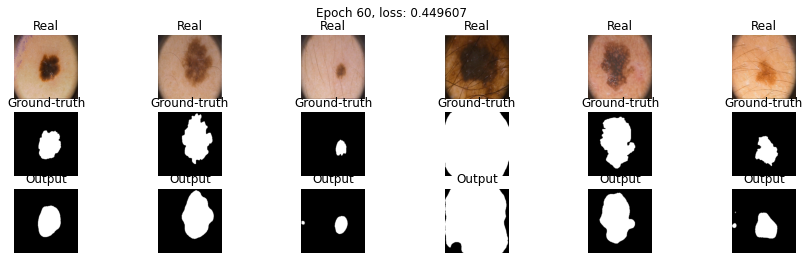

In [50]:
history_segnet_dice = train(data_tr, data_val, model_dice, optimizer, dice_loss, max_epochs, batch_size)

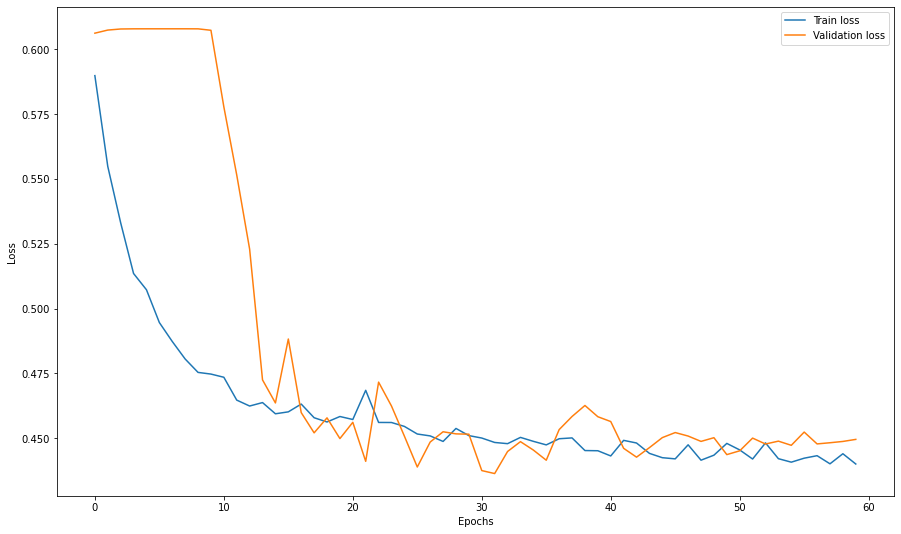

In [51]:
plot_loss(history_segnet_dice)

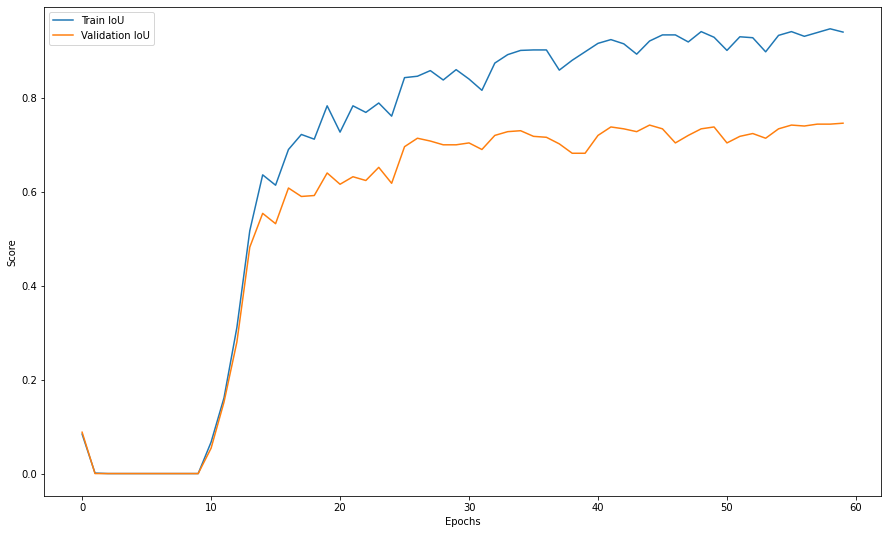

In [52]:
plot_metrics(history_segnet_dice)

In [53]:
score_segnet_dice = score_model(model_dice, iou_pytorch, data_val)
test_scores.append(score_segnet_dice)
score_segnet_dice

Scoring:   0%|          | 0/2 [00:00<?, ?it/s]

0.7460000216960907

In [54]:
#save_model(f"/content/segnet_dice_{max_epochs}.tar", model_dice, optim, dice_loss, max_epochs, history_segnet_dice)

In [55]:
save_history(f"/content/history_segnet_dice.pickle", history_segnet_dice)

In [56]:
model_dice = model_dice.to("cpu")
del model_dice
torch.cuda.empty_cache()

### Focal loss

[**2. Focal loss:**](https://arxiv.org/pdf/1708.02002.pdf) 

Окей, мы уже с вами умеем делать BCE loss:

$$\mathcal L_{BCE}(y, \hat y) = -\sum_i \left[y_i\log\sigma(\hat y_i) + (1-y_i)\log(1-\sigma(\hat y_i))\right].$$

Проблема с этой потерей заключается в том, что она имеет тенденцию приносить пользу классу **большинства** (фоновому) по отношению к классу **меньшинства** ( переднему). Поэтому обычно применяются весовые коэффициенты к каждому классу:

$$\mathcal L_{wBCE}(y, \hat y) = -\sum_i \alpha_i\left[y_i\log\sigma(\hat y_i) + (1-y_i)\log(1-\sigma(\hat y_i))\right].$$

Традиционно вес $\alpha_i$ определяется как обратная частота класса этого пикселя $i$, так что наблюдения миноритарного класса весят больше по отношению к классу большинства.

Еще одним недавним дополнением является взвешенный пиксельный вариант, которая взвешивает каждый пиксель по степени уверенности, которую мы имеем в предсказании этого пикселя.

$$\mathcal L_{focal}(y, \hat y) = -\sum_i \left[\left(1-\sigma(\hat y_i)\right)^\gamma y_i\log\sigma(\hat y_i) + (1-y_i)\log(1-\sigma(\hat y_i))\right].$$

Зафиксируем значение $\gamma=2$.

--------------------------------------------------------------------------------


In [57]:
def focal_loss(y_pred, y_real, eps = 1e-8, gamma = 2):
  BCE_loss = F.binary_cross_entropy_with_logits(y_pred, y_real, reduction='none')
  pt = torch.exp(-BCE_loss)
  focal = (1 - pt) ** gamma * BCE_loss
  return focal.mean()

### Training SegNet with Focal loss

In [58]:
model_focal = SegNet().to(device)
optimizer = torch.optim.AdamW(model_focal.parameters(), lr=1e-4)

In [59]:
summary(model_focal, (batch_size, 3, 256, 256))

Layer (type:depth-idx)                   Output Shape              Param #
SegNet                                   --                        --
├─Sequential: 1-1                        [25, 32, 256, 256]        --
│    └─Conv2d: 2-1                       [25, 32, 256, 256]        896
│    └─BatchNorm2d: 2-2                  [25, 32, 256, 256]        64
│    └─ReLU: 2-3                         [25, 32, 256, 256]        --
│    └─Conv2d: 2-4                       [25, 32, 256, 256]        9,248
│    └─BatchNorm2d: 2-5                  [25, 32, 256, 256]        64
│    └─ReLU: 2-6                         [25, 32, 256, 256]        --
├─MaxPool2d: 1-2                         [25, 32, 128, 128]        --
├─Sequential: 1-3                        [25, 64, 128, 128]        --
│    └─Conv2d: 2-7                       [25, 64, 128, 128]        18,496
│    └─BatchNorm2d: 2-8                  [25, 64, 128, 128]        128
│    └─ReLU: 2-9                         [25, 64, 128, 128]        --
│    └

In [60]:
!nvidia-smi

Fri Dec 10 21:47:03 2021       
+-----------------------------------------------------------------------------+
| NVIDIA-SMI 495.44       Driver Version: 460.32.03    CUDA Version: 11.2     |
|-------------------------------+----------------------+----------------------+
| GPU  Name        Persistence-M| Bus-Id        Disp.A | Volatile Uncorr. ECC |
| Fan  Temp  Perf  Pwr:Usage/Cap|         Memory-Usage | GPU-Util  Compute M. |
|                               |                      |               MIG M. |
|===============================+======================+======================|
|   0  Tesla K80           Off  | 00000000:00:04.0 Off |                    0 |
| N/A   72C    P0    78W / 149W |   3518MiB / 11441MiB |      0%      Default |
|                               |                      |                  N/A |
+-------------------------------+----------------------+----------------------+
                                                                               
+-------


Epoch 060 train_loss: 0.1310   val_loss 0.1326 train_iou 0.8550 val_iou 0.7240


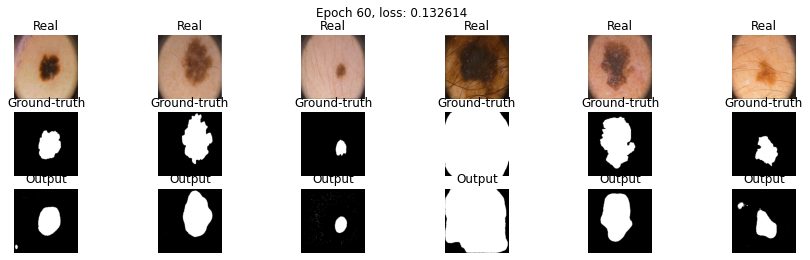

In [61]:
history_segnet_focal = train(data_tr, data_val, model_focal, optimizer, focal_loss, max_epochs, batch_size)

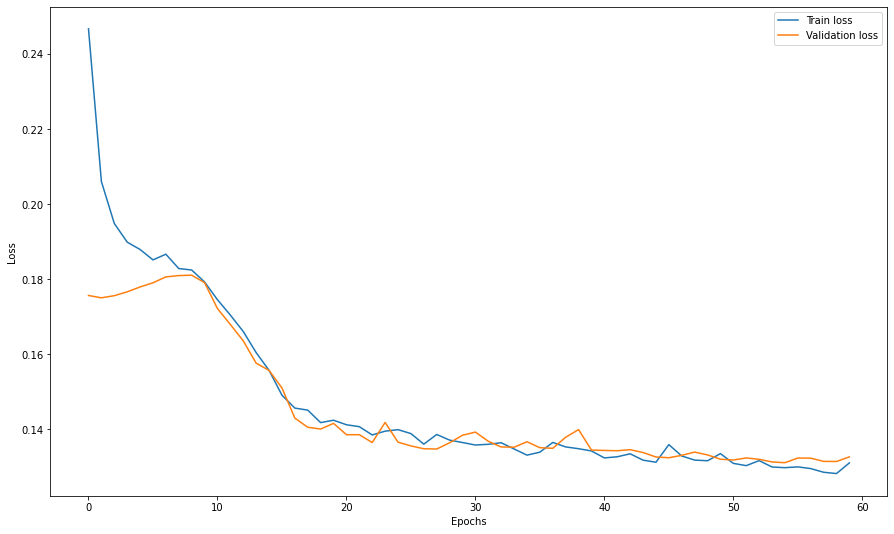

In [62]:
plot_loss(history_segnet_focal)

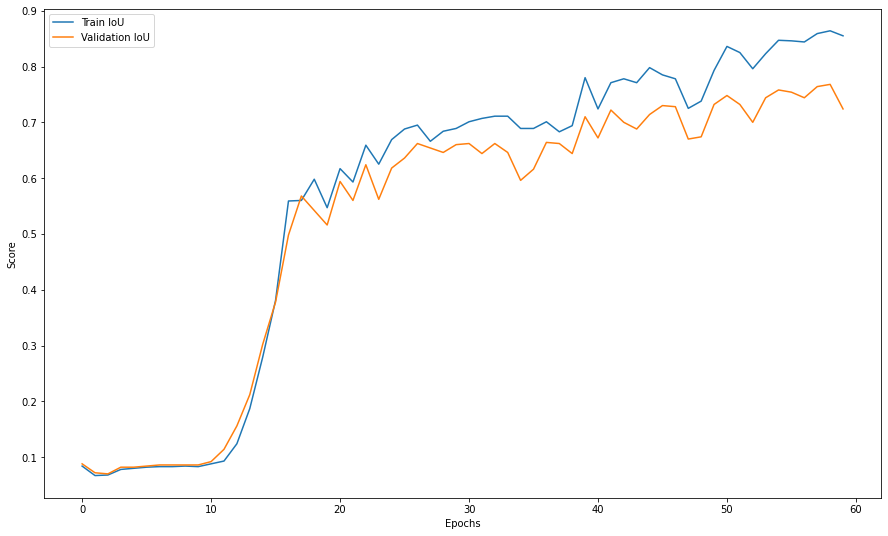

In [63]:
plot_metrics(history_segnet_focal)

In [64]:
score_segnet_focal = score_model(model_focal, iou_pytorch, data_val)
test_scores.append(score_segnet_focal)
score_segnet_focal

Scoring:   0%|          | 0/2 [00:00<?, ?it/s]

0.7239999771118164

In [65]:
#save_model(f"/content/segnet_focal_{max_epochs}.tar", model_focal, optim, focal_loss, max_epochs, history_segnet_focal)

In [66]:
save_history(f"/content/history_segnet_focal.pickle", history_segnet_focal)

In [67]:
model_focal = model_focal.to("cpu")
del model_focal
torch.cuda.empty_cache()

----------------------------------------------------------------------------------------------

## [BONUS] Мир сегментационных лоссов [5 баллов]

В данном блоке предлагаем вам написать одну функцию потерь самостоятельно. Для этого необходимо прочитать статью и имплементировать ее. Кроме тако провести численное сравнение с предыдущими функциями.
Какие варианты? 

1) Можно учесть Total Variation
2) Lova
3) BCE но с Soft Targets (что-то типа label-smoothing для многослассовой классификации)
4) Любой другой 

* [Physiological Inspired Deep Neural Networks for Emotion Recognition](https://ieeexplore.ieee.org/stamp/stamp.jsp?arnumber=8472816&tag=1)". IEEE Access, 6, 53930-53943.

* [Boundary loss for highly unbalanced segmentation](https://arxiv.org/abs/1812.07032)

* [Tversky loss function for image segmentation using 3D fully convolutional deep networks](https://arxiv.org/abs/1706.05721)

* [Correlation Maximized Structural Similarity Loss for Semantic Segmentation](https://arxiv.org/abs/1910.08711)

* [Topology-Preserving Deep Image Segmentation](https://papers.nips.cc/paper/8803-topology-preserving-deep-image-segmentation)

Так как Тверский лосс очень похож на данные выше, то за него будет проставлено только 3 балла (при условии, если в модели нет ошибок при обучении). Постарайтесь сделать что-то интереснее.

### Structural Similarity loss

In [68]:
def ssl_loss(inputs, targets, eps=1e-8, beta=0.1, weight=0.5):
  p = torch.sigmoid(inputs)
  c_4 = 0.01
  e_max = torch.abs(((targets - torch.mean(targets) + c_4) / (torch.std(targets) + c_4)) - ((torch.sigmoid(1 - targets) - torch.mean(torch.sigmoid(1 - targets)) + c_4) / (torch.std(torch.sigmoid(1 - targets)) + c_4)))
  e = torch.abs(((targets - torch.mean(targets) + c_4) / (torch.std(targets) + c_4)) - ((p - torch.mean(p) + c_4) / (torch.std(p) + c_4)))
  f = (e > (beta * e_max))
  ssl = (e * f * bce_loss(inputs, targets, reduction="none")).mean()
  bce = bce_loss(inputs, targets)
  return weight * bce + (1 - weight) * ssl

### Training SegNet with Structural Similarity loss

In [69]:
model_ssl = SegNet().to(device)
optimizer = torch.optim.AdamW(model_ssl.parameters(), lr=1e-4)

In [70]:
summary(model_ssl, (batch_size, 3, 256, 256))

Layer (type:depth-idx)                   Output Shape              Param #
SegNet                                   --                        --
├─Sequential: 1-1                        [25, 32, 256, 256]        --
│    └─Conv2d: 2-1                       [25, 32, 256, 256]        896
│    └─BatchNorm2d: 2-2                  [25, 32, 256, 256]        64
│    └─ReLU: 2-3                         [25, 32, 256, 256]        --
│    └─Conv2d: 2-4                       [25, 32, 256, 256]        9,248
│    └─BatchNorm2d: 2-5                  [25, 32, 256, 256]        64
│    └─ReLU: 2-6                         [25, 32, 256, 256]        --
├─MaxPool2d: 1-2                         [25, 32, 128, 128]        --
├─Sequential: 1-3                        [25, 64, 128, 128]        --
│    └─Conv2d: 2-7                       [25, 64, 128, 128]        18,496
│    └─BatchNorm2d: 2-8                  [25, 64, 128, 128]        128
│    └─ReLU: 2-9                         [25, 64, 128, 128]        --
│    └

In [71]:
!nvidia-smi

Fri Dec 10 22:01:16 2021       
+-----------------------------------------------------------------------------+
| NVIDIA-SMI 495.44       Driver Version: 460.32.03    CUDA Version: 11.2     |
|-------------------------------+----------------------+----------------------+
| GPU  Name        Persistence-M| Bus-Id        Disp.A | Volatile Uncorr. ECC |
| Fan  Temp  Perf  Pwr:Usage/Cap|         Memory-Usage | GPU-Util  Compute M. |
|                               |                      |               MIG M. |
|===============================+======================+======================|
|   0  Tesla K80           Off  | 00000000:00:04.0 Off |                    0 |
| N/A   72C    P0    79W / 149W |   3518MiB / 11441MiB |      0%      Default |
|                               |                      |                  N/A |
+-------------------------------+----------------------+----------------------+
                                                                               
+-------


Epoch 060 train_loss: 0.2923   val_loss 0.3262 train_iou 0.9220 val_iou 0.7220


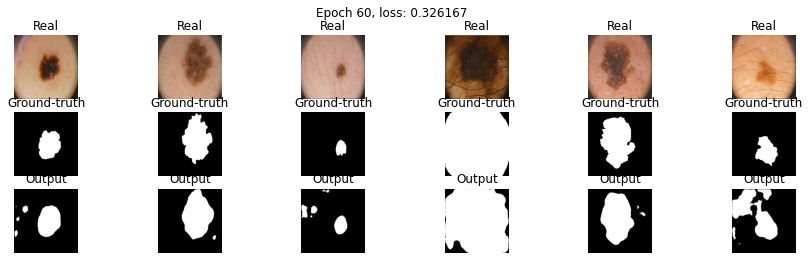

In [72]:
history_segnet_ssl = train(data_tr, data_val, model_ssl, optimizer, ssl_loss, max_epochs, batch_size)

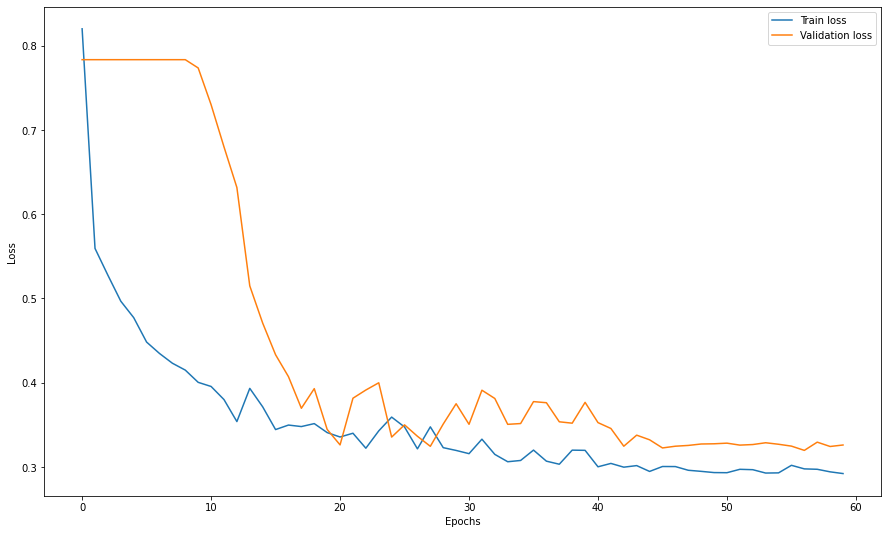

In [73]:
plot_loss(history_segnet_ssl)

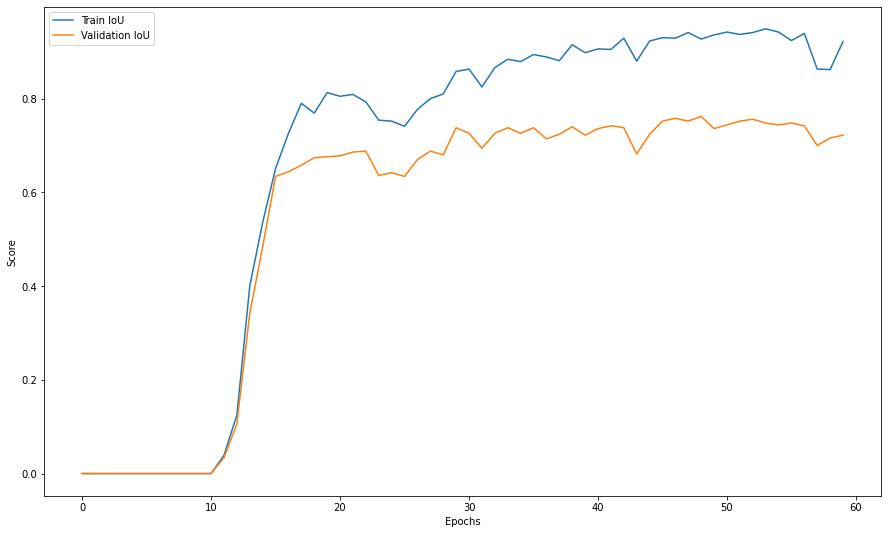

In [74]:
plot_metrics(history_segnet_ssl)

In [75]:
score_segnet_ssl = score_model(model_ssl, iou_pytorch, data_val)
test_scores.append(score_segnet_ssl)
score_segnet_ssl

Scoring:   0%|          | 0/2 [00:00<?, ?it/s]

0.722000002861023

In [76]:
#save_model(f"/content/segnet_ssl_{max_epochs}.tar", model_ssl, optim, ssl_loss, max_epochs, history_segnet_ssl)

In [77]:
save_history(f"/content/history_segnet_ssl.pickle", history_segnet_ssl)

In [78]:
model_ssl = model_ssl.to("cpu")
del model_ssl
torch.cuda.empty_cache()

-----------------------------------------------------------------------------------------

## U-Net [2 балла]

[**U-Net**](https://arxiv.org/abs/1505.04597) — это архитектура нейронной сети, которая получает изображение и выводит его. Первоначально он был задуман для семантической сегментации (как мы ее будем использовать), но он настолько успешен, что с тех пор используется в других контекстах. Получая на вход медицинское изображение, он выведет изображение в оттенках серого, где интенсивность каждого пикселя зависит от вероятности того, что этот пиксель принадлежит интересующей нас области.

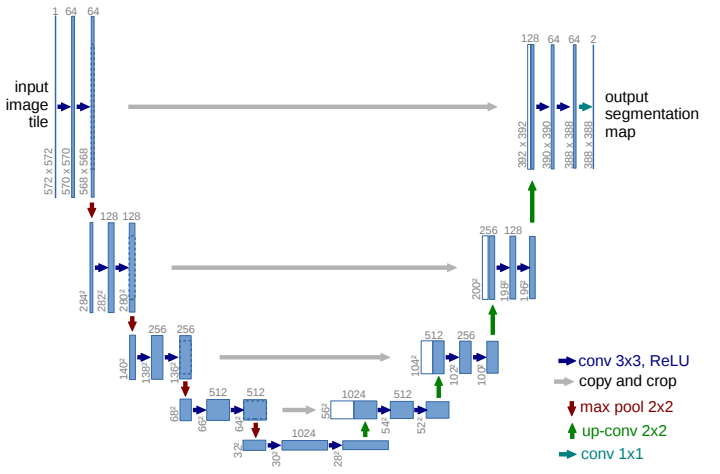

У нас в архитектуре все так же существует энкодер и декодер, как в **SegNet**, но отличительной особеностью данной модели являются *skip-conenctions*, соединяющие части декодера и энкодера. То есть для того чтобы передать на вход декодера тензор, мы конкатенируем симметричный выход с энкодера и выход предыдущего слоя декодера.

* Ronneberger, Olaf, Philipp Fischer, and Thomas Brox. "[U-Net: Convolutional networks for biomedical image segmentation.](https://arxiv.org/pdf/1505.04597.pdf)" International Conference on Medical image computing and computer-assisted intervention. Springer, Cham, 2015.

### Init model

In [79]:
class UNet(nn.Module):
    def __init__(self):
        super().__init__()

        # encoder (downsampling)
        # Each enc_conv/dec_conv block should look like this:
        # nn.Sequential(
        #     nn.Conv2d(...),
        #     ... (2 or 3 conv layers with relu and batchnorm),
        # )
        self.enc_conv0 = nn.Sequential(
            nn.Conv2d(in_channels=3, out_channels=32, kernel_size=3, padding=1),
            nn.BatchNorm2d(32),
            nn.ReLU(),

            nn.Conv2d(in_channels=32, out_channels=32, kernel_size=3, padding=1),
            nn.BatchNorm2d(32),
            nn.ReLU(),
        )
        self.pool0 = nn.MaxPool2d(kernel_size=2, stride=2, return_indices=True) # 256 -> 128
        self.enc_conv1 = nn.Sequential(
            nn.Conv2d(in_channels=32, out_channels=64, kernel_size=3, padding=1),
            nn.BatchNorm2d(64),
            nn.ReLU(),

            nn.Conv2d(in_channels=64, out_channels=64, kernel_size=3, padding=1),
            nn.BatchNorm2d(64),
            nn.ReLU(),
        )
        self.pool1 = nn.MaxPool2d(kernel_size=2, stride=2, return_indices=True) # 128 -> 64
        self.enc_conv2 = nn.Sequential(
            nn.Conv2d(in_channels=64, out_channels=128, kernel_size=3, padding=1),
            nn.BatchNorm2d(128),
            nn.ReLU(),

            nn.Conv2d(in_channels=128, out_channels=128, kernel_size=3, padding=1),
            nn.BatchNorm2d(128),
            nn.ReLU(),
        )
        self.pool2 = nn.MaxPool2d(kernel_size=2, stride=2, return_indices=True) # 64 -> 32
        self.enc_conv3 = nn.Sequential(
            nn.Conv2d(in_channels=128, out_channels=256, kernel_size=3, padding=1),
            nn.BatchNorm2d(256),
            nn.ReLU(),

            nn.Conv2d(in_channels=256, out_channels=256, kernel_size=3, padding=1),
            nn.BatchNorm2d(256),
            nn.ReLU(),
        )
        self.pool3 = nn.MaxPool2d(kernel_size=2, stride=2, return_indices=True) # 32 -> 16

        # bottleneck
        self.bottleneck_conv = nn.Sequential(
            nn.Conv2d(in_channels=256, out_channels=512, kernel_size=1),
            nn.BatchNorm2d(512),
            nn.ReLU(),

            nn.Conv2d(in_channels=512, out_channels=256, kernel_size=1),
            nn.BatchNorm2d(256),
            nn.ReLU()
        )

        # decoder (upsampling)
        self.upsample0 = nn.MaxUnpool2d(kernel_size=2, stride=2) # 16 -> 32
        self.dec_conv0 = nn.Sequential(
            nn.Conv2d(in_channels=512, out_channels=256, kernel_size=3, padding=1),
            nn.ReLU(),
            nn.BatchNorm2d(256),

            nn.Conv2d(in_channels=256, out_channels=128, kernel_size=3, padding=1),
            nn.ReLU(),
            nn.BatchNorm2d(128)
        )
        self.upsample1 = nn.MaxUnpool2d(kernel_size=2, stride=2) # 32 -> 64
        self.dec_conv1 = nn.Sequential(
            nn.Conv2d(in_channels=256, out_channels=128, kernel_size=3, padding=1),
            nn.ReLU(),
            nn.BatchNorm2d(128),

            nn.Conv2d(in_channels=128, out_channels=64, kernel_size=3, padding=1),
            nn.ReLU(),
            nn.BatchNorm2d(64)
        )
        self.upsample2 = nn.MaxUnpool2d(kernel_size=2, stride=2)  # 64 -> 128
        self.dec_conv2 = nn.Sequential(
            nn.Conv2d(in_channels=128, out_channels=64, kernel_size=3, padding=1),
            nn.ReLU(),
            nn.BatchNorm2d(64),

            nn.Conv2d(in_channels=64, out_channels=32, kernel_size=3, padding=1),
            nn.ReLU(),
            nn.BatchNorm2d(32)
        )
        self.upsample3 = nn.MaxUnpool2d(kernel_size=2, stride=2) # 128 -> 256
        self.dec_conv3 = nn.Sequential(
            nn.Conv2d(in_channels=64, out_channels=32, kernel_size=3, padding=1),
            nn.ReLU(),
            nn.BatchNorm2d(32),

            nn.Conv2d(in_channels=32, out_channels=32, kernel_size=3, padding=1),
            nn.ReLU(),
            nn.BatchNorm2d(32),

            nn.Conv2d(in_channels=32, out_channels=1, kernel_size=3, padding=1)
        )

    def forward(self, x):
        # encoder
        e0 = self.enc_conv0(x)
        p0, pool_idx0 = self.pool0(e0)
        e1 = self.enc_conv1(p0)
        p1, pool_idx1 = self.pool1(e1)
        e2 = self.enc_conv2(p1)
        p2, pool_idx2 = self.pool2(e2)
        e3 = self.enc_conv3(p2)
        p3, pool_idx3 = self.pool3(e3)

        # bottleneck
        b = self.bottleneck_conv(p3)

        # decoder
        u0 = self.upsample0(b, pool_idx3)
        skipcon0 = torch.cat((e3, u0), dim=1)
        d0 = self.dec_conv0(skipcon0)
        u1 = self.upsample1(d0, pool_idx2)
        skipcon1 = torch.cat((e2, u1), dim=1)
        d1 = self.dec_conv1(skipcon1)
        u2 = self.upsample2(d1, pool_idx1)
        skipcon2 = torch.cat((e1, u2), dim=1)
        d2 = self.dec_conv2(skipcon2)
        u3 = self.upsample3(d2, pool_idx0)
        skipcon3 = torch.cat((e0, u3), dim=1)
        d3 = self.dec_conv3(skipcon3) # no activation
        return d3

### UNet BCE loss training

In [80]:
unet_bce = UNet().to(device)

In [81]:
summary(unet_bce, (batch_size, 3, 256, 256))

Layer (type:depth-idx)                   Output Shape              Param #
UNet                                     --                        --
├─Sequential: 1-1                        [25, 32, 256, 256]        --
│    └─Conv2d: 2-1                       [25, 32, 256, 256]        896
│    └─BatchNorm2d: 2-2                  [25, 32, 256, 256]        64
│    └─ReLU: 2-3                         [25, 32, 256, 256]        --
│    └─Conv2d: 2-4                       [25, 32, 256, 256]        9,248
│    └─BatchNorm2d: 2-5                  [25, 32, 256, 256]        64
│    └─ReLU: 2-6                         [25, 32, 256, 256]        --
├─MaxPool2d: 1-2                         [25, 32, 128, 128]        --
├─Sequential: 1-3                        [25, 64, 128, 128]        --
│    └─Conv2d: 2-7                       [25, 64, 128, 128]        18,496
│    └─BatchNorm2d: 2-8                  [25, 64, 128, 128]        128
│    └─ReLU: 2-9                         [25, 64, 128, 128]        --
│    └

In [82]:
!nvidia-smi

Fri Dec 10 22:15:47 2021       
+-----------------------------------------------------------------------------+
| NVIDIA-SMI 495.44       Driver Version: 460.32.03    CUDA Version: 11.2     |
|-------------------------------+----------------------+----------------------+
| GPU  Name        Persistence-M| Bus-Id        Disp.A | Volatile Uncorr. ECC |
| Fan  Temp  Perf  Pwr:Usage/Cap|         Memory-Usage | GPU-Util  Compute M. |
|                               |                      |               MIG M. |
|===============================+======================+======================|
|   0  Tesla K80           Off  | 00000000:00:04.0 Off |                    0 |
| N/A   72C    P0    79W / 149W |   5824MiB / 11441MiB |      0%      Default |
|                               |                      |                  N/A |
+-------------------------------+----------------------+----------------------+
                                                                               
+-------

In [83]:
optim = torch.optim.AdamW(unet_bce.parameters(), lr=1e-4)


Epoch 060 train_loss: 0.0532   val_loss 0.1585 train_iou 0.9750 val_iou 0.7500


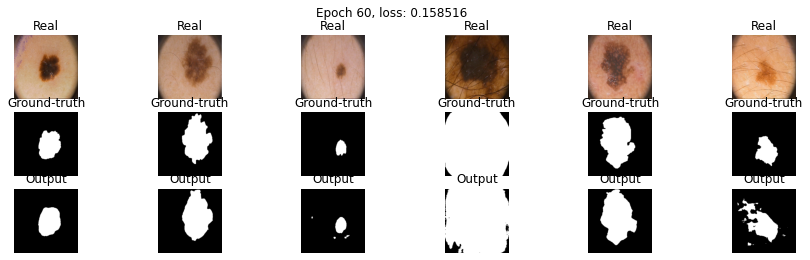

In [84]:
history_unet_bce = train(data_tr, data_val, unet_bce, optim, bce_loss, max_epochs, batch_size)

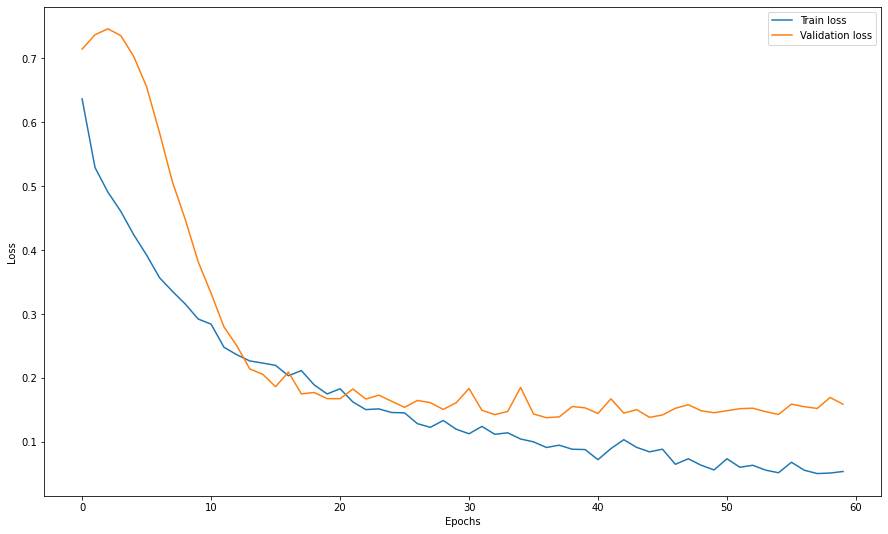

In [85]:
plot_loss(history_unet_bce)

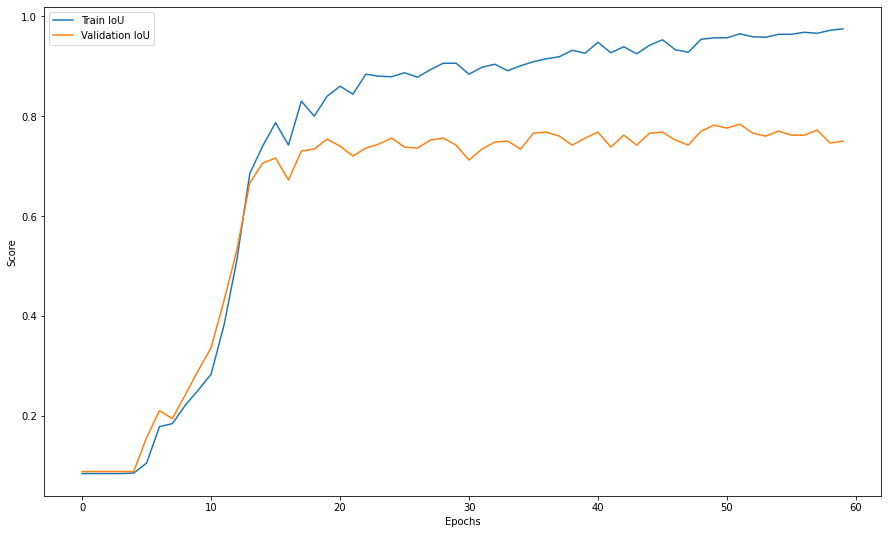

In [86]:
plot_metrics(history_unet_bce)

In [88]:
score_unet_bce = score_model(unet_bce, iou_pytorch, data_val)
test_scores.append(score_unet_bce)
score_unet_bce

Scoring:   0%|          | 0/2 [00:00<?, ?it/s]

0.7500000298023224

In [89]:
#save_model(f"/content/unet_bce_{max_epochs}.tar", unet_bce, optim, bce_loss, max_epochs, history_unet_bce)

In [90]:
save_history(f"/content/history_unet_bce.pickle", history_unet_bce)

In [91]:
unet_bce = unet_bce.to("cpu")
del unet_bce
torch.cuda.empty_cache()

### UNet Dice loss training

In [92]:
unet_dice = UNet().to(device)

In [93]:
summary(unet_dice, (batch_size, 3, 256, 256))

Layer (type:depth-idx)                   Output Shape              Param #
UNet                                     --                        --
├─Sequential: 1-1                        [25, 32, 256, 256]        --
│    └─Conv2d: 2-1                       [25, 32, 256, 256]        896
│    └─BatchNorm2d: 2-2                  [25, 32, 256, 256]        64
│    └─ReLU: 2-3                         [25, 32, 256, 256]        --
│    └─Conv2d: 2-4                       [25, 32, 256, 256]        9,248
│    └─BatchNorm2d: 2-5                  [25, 32, 256, 256]        64
│    └─ReLU: 2-6                         [25, 32, 256, 256]        --
├─MaxPool2d: 1-2                         [25, 32, 128, 128]        --
├─Sequential: 1-3                        [25, 64, 128, 128]        --
│    └─Conv2d: 2-7                       [25, 64, 128, 128]        18,496
│    └─BatchNorm2d: 2-8                  [25, 64, 128, 128]        128
│    └─ReLU: 2-9                         [25, 64, 128, 128]        --
│    └

In [94]:
!nvidia-smi

Fri Dec 10 22:32:28 2021       
+-----------------------------------------------------------------------------+
| NVIDIA-SMI 495.44       Driver Version: 460.32.03    CUDA Version: 11.2     |
|-------------------------------+----------------------+----------------------+
| GPU  Name        Persistence-M| Bus-Id        Disp.A | Volatile Uncorr. ECC |
| Fan  Temp  Perf  Pwr:Usage/Cap|         Memory-Usage | GPU-Util  Compute M. |
|                               |                      |               MIG M. |
|===============================+======================+======================|
|   0  Tesla K80           Off  | 00000000:00:04.0 Off |                    0 |
| N/A   72C    P0    81W / 149W |   4796MiB / 11441MiB |      0%      Default |
|                               |                      |                  N/A |
+-------------------------------+----------------------+----------------------+
                                                                               
+-------

In [95]:
optim = torch.optim.AdamW(unet_dice.parameters(), lr=1e-4)


Epoch 060 train_loss: 0.0453   val_loss 0.0768 train_iou 0.9440 val_iou 0.7960


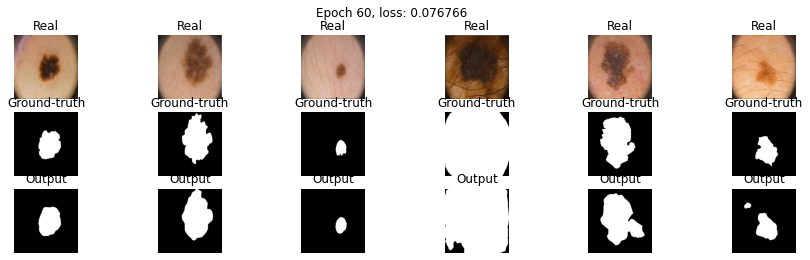

In [96]:
history_unet_dice = train(data_tr, data_val, unet_dice, optim, dice_loss, max_epochs, batch_size)

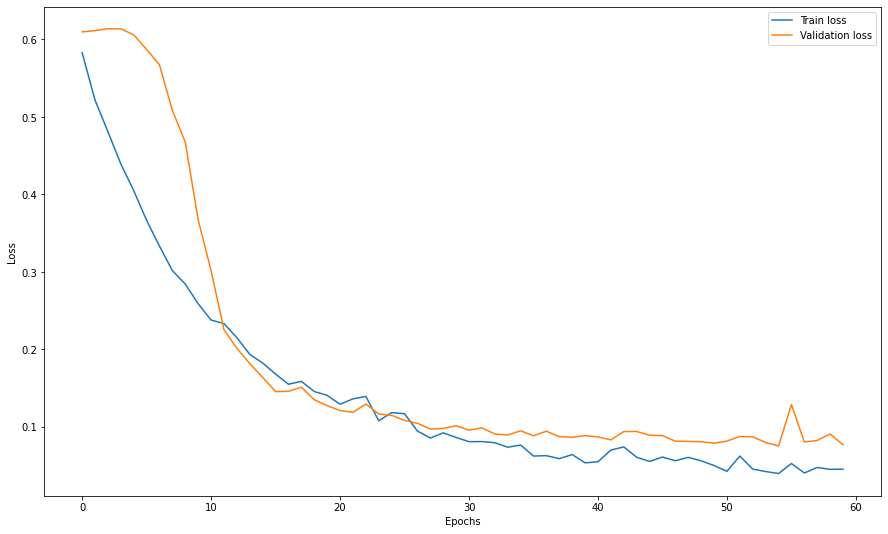

In [97]:
plot_loss(history_unet_dice)

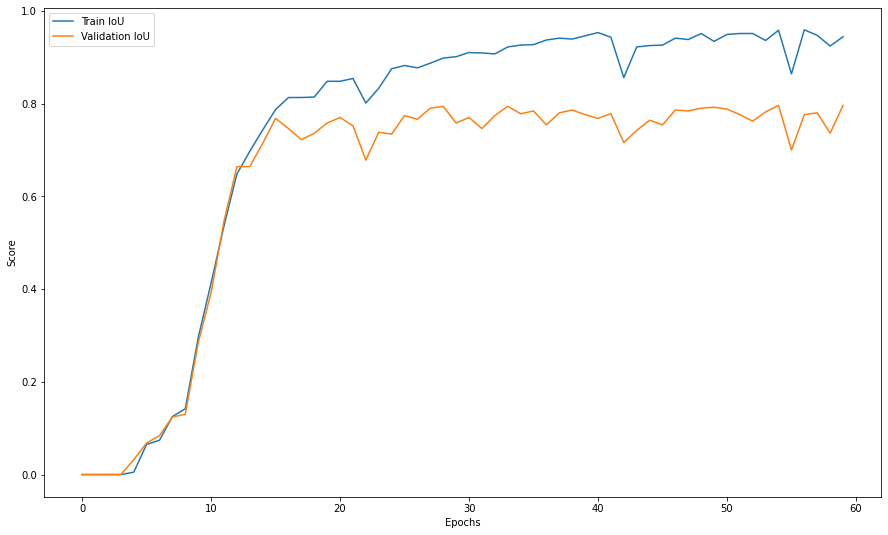

In [98]:
plot_metrics(history_unet_dice)

In [99]:
score_unet_dice = score_model(unet_dice, iou_pytorch, data_ts)
test_scores.append(score_unet_dice)
score_unet_dice

Scoring:   0%|          | 0/2 [00:00<?, ?it/s]

0.7300000190734863

In [100]:
#save_model(f"/content/unet_dice_{max_epochs}.tar", unet_dice, optim, dice_loss, max_epochs, history_unet_dice)

In [101]:
save_history("/content/history_unet_dice.pickle", history_unet_dice)

In [102]:
unet_dice = unet_dice.to("cpu")
del unet_dice
torch.cuda.empty_cache()

### UNet Focal loss training

In [103]:
unet_focal = UNet().to(device)

In [104]:
summary(unet_focal, (batch_size, 3, 256, 256))

Layer (type:depth-idx)                   Output Shape              Param #
UNet                                     --                        --
├─Sequential: 1-1                        [25, 32, 256, 256]        --
│    └─Conv2d: 2-1                       [25, 32, 256, 256]        896
│    └─BatchNorm2d: 2-2                  [25, 32, 256, 256]        64
│    └─ReLU: 2-3                         [25, 32, 256, 256]        --
│    └─Conv2d: 2-4                       [25, 32, 256, 256]        9,248
│    └─BatchNorm2d: 2-5                  [25, 32, 256, 256]        64
│    └─ReLU: 2-6                         [25, 32, 256, 256]        --
├─MaxPool2d: 1-2                         [25, 32, 128, 128]        --
├─Sequential: 1-3                        [25, 64, 128, 128]        --
│    └─Conv2d: 2-7                       [25, 64, 128, 128]        18,496
│    └─BatchNorm2d: 2-8                  [25, 64, 128, 128]        128
│    └─ReLU: 2-9                         [25, 64, 128, 128]        --
│    └

In [105]:
!nvidia-smi

Fri Dec 10 22:48:36 2021       
+-----------------------------------------------------------------------------+
| NVIDIA-SMI 495.44       Driver Version: 460.32.03    CUDA Version: 11.2     |
|-------------------------------+----------------------+----------------------+
| GPU  Name        Persistence-M| Bus-Id        Disp.A | Volatile Uncorr. ECC |
| Fan  Temp  Perf  Pwr:Usage/Cap|         Memory-Usage | GPU-Util  Compute M. |
|                               |                      |               MIG M. |
|===============================+======================+======================|
|   0  Tesla K80           Off  | 00000000:00:04.0 Off |                    0 |
| N/A   71C    P0    78W / 149W |   4796MiB / 11441MiB |      0%      Default |
|                               |                      |                  N/A |
+-------------------------------+----------------------+----------------------+
                                                                               
+-------

In [106]:
optim = torch.optim.AdamW(unet_focal.parameters(), lr=1e-4)


Epoch 060 train_loss: 0.0093   val_loss 0.0407 train_iou 0.9730 val_iou 0.7380


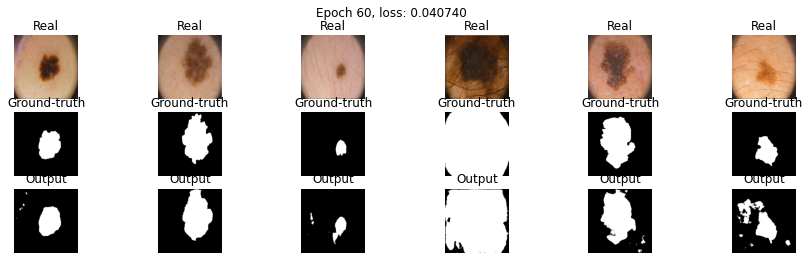

In [107]:
history_unet_focal = train(data_tr, data_val, unet_focal, optim, focal_loss, max_epochs, batch_size)

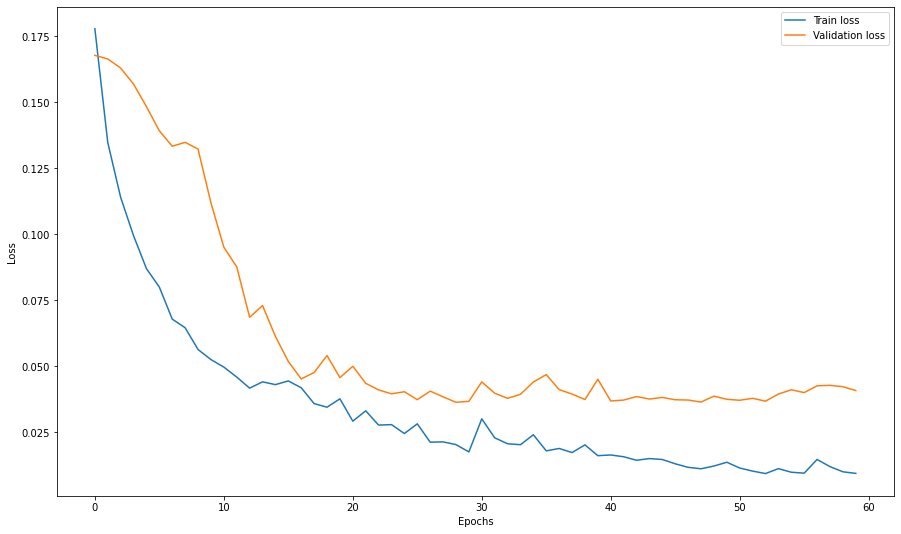

In [108]:
plot_loss(history_unet_focal)

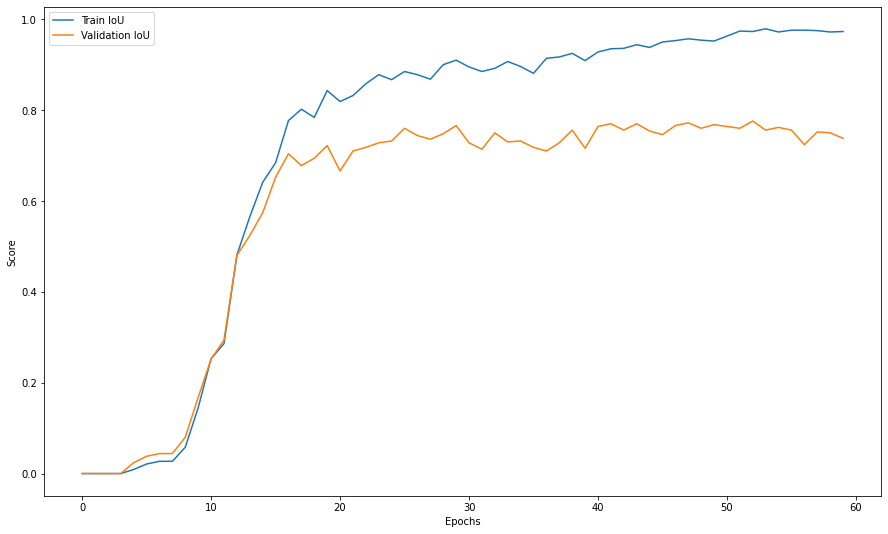

In [109]:
plot_metrics(history_unet_focal)

In [110]:
score_unet_focal = score_model(unet_focal, iou_pytorch, data_ts)
test_scores.append(score_unet_focal)
score_unet_focal

Scoring:   0%|          | 0/2 [00:00<?, ?it/s]

0.7480000257492065

In [111]:
#save_model(f"/content/unet_focal_{max_epochs}.tar", unet_focal, optim, focal_loss, max_epochs, history_unet_focal)

In [112]:
save_history("/content/history_unet_focal.pickle", history_unet_focal)

In [113]:
unet_focal = unet_focal.to("cpu")
del unet_focal
torch.cuda.empty_cache()

### UNet Structural Similarity Loss training

In [114]:
unet_ssl = UNet().to(device)

In [115]:
summary(unet_ssl, (batch_size, 3, 256, 256))

Layer (type:depth-idx)                   Output Shape              Param #
UNet                                     --                        --
├─Sequential: 1-1                        [25, 32, 256, 256]        --
│    └─Conv2d: 2-1                       [25, 32, 256, 256]        896
│    └─BatchNorm2d: 2-2                  [25, 32, 256, 256]        64
│    └─ReLU: 2-3                         [25, 32, 256, 256]        --
│    └─Conv2d: 2-4                       [25, 32, 256, 256]        9,248
│    └─BatchNorm2d: 2-5                  [25, 32, 256, 256]        64
│    └─ReLU: 2-6                         [25, 32, 256, 256]        --
├─MaxPool2d: 1-2                         [25, 32, 128, 128]        --
├─Sequential: 1-3                        [25, 64, 128, 128]        --
│    └─Conv2d: 2-7                       [25, 64, 128, 128]        18,496
│    └─BatchNorm2d: 2-8                  [25, 64, 128, 128]        128
│    └─ReLU: 2-9                         [25, 64, 128, 128]        --
│    └

In [116]:
!nvidia-smi

Fri Dec 10 23:05:15 2021       
+-----------------------------------------------------------------------------+
| NVIDIA-SMI 495.44       Driver Version: 460.32.03    CUDA Version: 11.2     |
|-------------------------------+----------------------+----------------------+
| GPU  Name        Persistence-M| Bus-Id        Disp.A | Volatile Uncorr. ECC |
| Fan  Temp  Perf  Pwr:Usage/Cap|         Memory-Usage | GPU-Util  Compute M. |
|                               |                      |               MIG M. |
|===============================+======================+======================|
|   0  Tesla K80           Off  | 00000000:00:04.0 Off |                    0 |
| N/A   72C    P0    78W / 149W |   4796MiB / 11441MiB |      0%      Default |
|                               |                      |                  N/A |
+-------------------------------+----------------------+----------------------+
                                                                               
+-------

In [117]:
optim = torch.optim.AdamW(unet_ssl.parameters(), lr=1e-4)


Epoch 060 train_loss: 0.0517   val_loss 0.1734 train_iou 0.9750 val_iou 0.7300


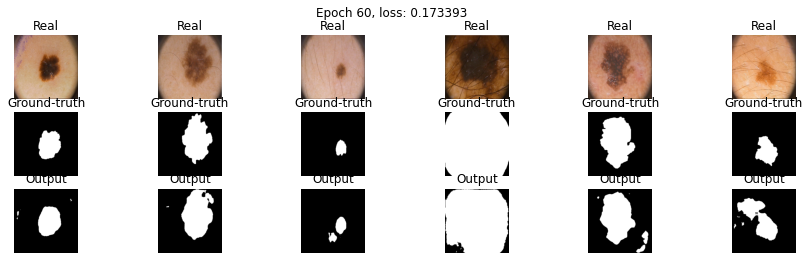

In [118]:
history_unet_ssl = train(data_tr, data_val, unet_ssl, optim, ssl_loss, max_epochs, batch_size)

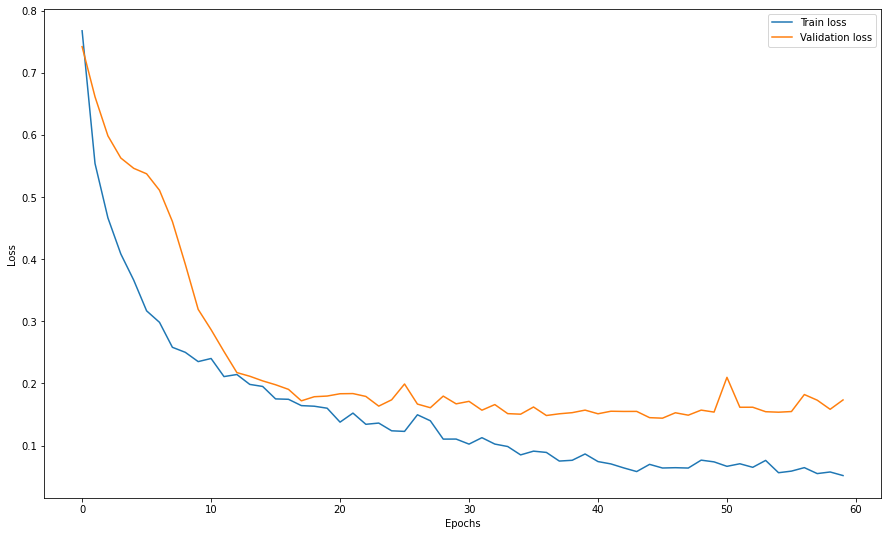

In [119]:
plot_loss(history_unet_ssl)

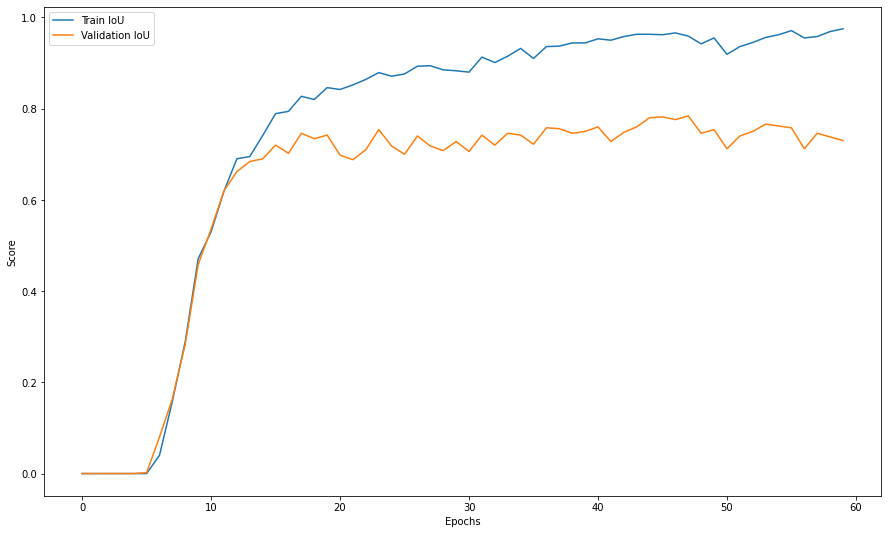

In [120]:
plot_metrics(history_unet_ssl)

In [121]:
score_unet_ssl = score_model(unet_ssl, iou_pytorch, data_ts)
test_scores.append(score_unet_ssl)
score_unet_ssl

Scoring:   0%|          | 0/2 [00:00<?, ?it/s]

0.7260000109672546

In [122]:
#save_model(f"/content/unet_ssl_{max_epochs}.tar", unet_ssl, optim, ssl_loss, max_epochs, history_unet_ssl)

In [123]:
save_history("/content/history_unet_ssl.pickle", history_unet_ssl)

In [124]:
unet_ssl = unet_ssl.to("cpu")
del unet_ssl
torch.cuda.empty_cache()

## U-Net modification

Новая модель путем изменения типа пулинга:

 **Max-Pooling** for the downsampling and **nearest-neighbor Upsampling** for the upsampling.

Down-sampling:

        conv = nn.Conv2d(3, 64, 3, padding=1)
        pool = nn.MaxPool2d(3, 2, padding=1)

Up-Sampling

        upsample = nn.Upsample(32)
        conv = nn.Conv2d(64, 64, 3, padding=1)

Замените max-pooling на convolutions с stride=2 и upsampling на transpose-convolutions с stride=2.


### Init model

In [125]:
class UNet2(nn.Module):
  def __init__(self):
    super().__init__()

    # encoder (downsampling)
    # Each enc_conv/dec_conv block should look like this:
    # nn.Sequential(
    #     nn.Conv2d(...),
    #     ... (2 or 3 conv layers with relu and batchnorm),
    # )
    self.enc_conv0 = nn.Sequential(
        nn.Conv2d(in_channels=3, out_channels=32, kernel_size=3, padding=1),
        nn.BatchNorm2d(32),
        nn.ReLU(),

        nn.Conv2d(in_channels=32, out_channels=32, kernel_size=3, padding=1),
        nn.BatchNorm2d(32),
        nn.ReLU(),
    )
    self.pool0 = nn.Conv2d(in_channels=32, out_channels=32, kernel_size=2, stride=2) # 256 -> 128
    self.enc_conv1 = nn.Sequential(
        nn.Conv2d(in_channels=32, out_channels=64, kernel_size=3, padding=1),
        nn.BatchNorm2d(64),
        nn.ReLU(),

        nn.Conv2d(in_channels=64, out_channels=64, kernel_size=3, padding=1),
        nn.BatchNorm2d(64),
        nn.ReLU(),
    )
    self.pool1 = nn.Conv2d(in_channels=64, out_channels=64, kernel_size=2, stride=2) # 128 -> 64
    self.enc_conv2 = nn.Sequential(
        nn.Conv2d(in_channels=64, out_channels=128, kernel_size=3, padding=1),
        nn.BatchNorm2d(128),
        nn.ReLU(),

        nn.Conv2d(in_channels=128, out_channels=128, kernel_size=3, padding=1),
        nn.BatchNorm2d(128),
        nn.ReLU(),
    )
    self.pool2 = nn.Conv2d(in_channels=128, out_channels=128, kernel_size=2, stride=2) # 64 -> 32
    self.enc_conv3 = nn.Sequential(
        nn.Conv2d(in_channels=128, out_channels=256, kernel_size=3, padding=1),
        nn.BatchNorm2d(256),
        nn.ReLU(),

        nn.Conv2d(in_channels=256, out_channels=256, kernel_size=3, padding=1),
        nn.BatchNorm2d(256),
        nn.ReLU(),
    )
    self.pool3 = nn.Conv2d(in_channels=256, out_channels=256, kernel_size=2, stride=2) # 32 -> 16

    # bottleneck
    self.bottleneck_conv = nn.Sequential(
        nn.Conv2d(in_channels=256, out_channels=512, kernel_size=1),
        nn.BatchNorm2d(512),
        nn.ReLU(),

        nn.Conv2d(in_channels=512, out_channels=256, kernel_size=1),
        nn.BatchNorm2d(256),
        nn.ReLU()
    )

    # decoder (upsampling)
    self.upsample0 = nn.ConvTranspose2d(in_channels=256, out_channels=256, kernel_size=2, stride=2) # 16 -> 32
    self.dec_conv0 = nn.Sequential(
        nn.Conv2d(in_channels=512, out_channels=256, kernel_size=3, padding=1),
        nn.ReLU(),
        nn.BatchNorm2d(256),

        nn.Conv2d(in_channels=256, out_channels=128, kernel_size=3, padding=1),
        nn.ReLU(),
        nn.BatchNorm2d(128)
    )
    self.upsample1 = nn.ConvTranspose2d(in_channels=128, out_channels=128, kernel_size=2, stride=2) # 32 -> 64
    self.dec_conv1 = nn.Sequential(
        nn.Conv2d(in_channels=256, out_channels=128, kernel_size=3, padding=1),
        nn.ReLU(),
        nn.BatchNorm2d(128),

        nn.Conv2d(in_channels=128, out_channels=64, kernel_size=3, padding=1),
        nn.ReLU(),
        nn.BatchNorm2d(64)
    )
    self.upsample2 = nn.ConvTranspose2d(in_channels=64, out_channels=64, kernel_size=2, stride=2)  # 64 -> 128
    self.dec_conv2 = nn.Sequential(
        nn.Conv2d(in_channels=128, out_channels=64, kernel_size=3, padding=1),
        nn.ReLU(),
        nn.BatchNorm2d(64),

        nn.Conv2d(in_channels=64, out_channels=32, kernel_size=3, padding=1),
        nn.ReLU(),
        nn.BatchNorm2d(32)
    )
    self.upsample3 = nn.ConvTranspose2d(in_channels=32, out_channels=32, kernel_size=2, stride=2) # 128 -> 256
    self.dec_conv3 = nn.Sequential(
        nn.Conv2d(in_channels=64, out_channels=32, kernel_size=3, padding=1),
        nn.ReLU(),
        nn.BatchNorm2d(32),

        nn.Conv2d(in_channels=32, out_channels=32, kernel_size=3, padding=1),
        nn.ReLU(),
        nn.BatchNorm2d(32),

        nn.Conv2d(in_channels=32, out_channels=1, kernel_size=3, padding=1)
    )

  def forward(self, x):
    # encoder
    e0 = self.enc_conv0(x)
    p0 = self.pool0(e0)
    e1 = self.enc_conv1(p0)
    p1 = self.pool1(e1)
    e2 = self.enc_conv2(p1)
    p2 = self.pool2(e2)
    e3 = self.enc_conv3(p2)
    p3 = self.pool3(e3)

    # bottleneck
    b = self.bottleneck_conv(p3)

    # decoder
    u0 = self.upsample0(b)
    skipcon0 = torch.cat((e3, u0), dim=1)
    d0 = self.dec_conv0(skipcon0)
    u1 = self.upsample1(d0)
    skipcon1 = torch.cat((e2, u1), dim=1)
    d1 = self.dec_conv1(skipcon1)
    u2 = self.upsample2(d1)
    skipcon2 = torch.cat((e1, u2), dim=1)
    d2 = self.dec_conv2(skipcon2)
    u3 = self.upsample3(d2)
    skipcon3 = torch.cat((e0, u3), dim=1)
    d3 = self.dec_conv3(skipcon3) # no activation
    return d3

### UNet modified BCE loss training

In [126]:
unet2_bce = UNet2().to(device)

In [127]:
summary(unet2_bce, (batch_size, 3, 256, 256))

Layer (type:depth-idx)                   Output Shape              Param #
UNet2                                    --                        --
├─Sequential: 1-1                        [25, 32, 256, 256]        --
│    └─Conv2d: 2-1                       [25, 32, 256, 256]        896
│    └─BatchNorm2d: 2-2                  [25, 32, 256, 256]        64
│    └─ReLU: 2-3                         [25, 32, 256, 256]        --
│    └─Conv2d: 2-4                       [25, 32, 256, 256]        9,248
│    └─BatchNorm2d: 2-5                  [25, 32, 256, 256]        64
│    └─ReLU: 2-6                         [25, 32, 256, 256]        --
├─Conv2d: 1-2                            [25, 32, 128, 128]        4,128
├─Sequential: 1-3                        [25, 64, 128, 128]        --
│    └─Conv2d: 2-7                       [25, 64, 128, 128]        18,496
│    └─BatchNorm2d: 2-8                  [25, 64, 128, 128]        128
│    └─ReLU: 2-9                         [25, 64, 128, 128]        --
│  

In [128]:
!nvidia-smi

Fri Dec 10 23:22:01 2021       
+-----------------------------------------------------------------------------+
| NVIDIA-SMI 495.44       Driver Version: 460.32.03    CUDA Version: 11.2     |
|-------------------------------+----------------------+----------------------+
| GPU  Name        Persistence-M| Bus-Id        Disp.A | Volatile Uncorr. ECC |
| Fan  Temp  Perf  Pwr:Usage/Cap|         Memory-Usage | GPU-Util  Compute M. |
|                               |                      |               MIG M. |
|===============================+======================+======================|
|   0  Tesla K80           Off  | 00000000:00:04.0 Off |                    0 |
| N/A   72C    P0    78W / 149W |   4796MiB / 11441MiB |      0%      Default |
|                               |                      |                  N/A |
+-------------------------------+----------------------+----------------------+
                                                                               
+-------

In [129]:
optim = torch.optim.AdamW(unet2_bce.parameters(), lr=1e-4)


Epoch 060 train_loss: 0.0454   val_loss 0.1381 train_iou 0.9850 val_iou 0.7800


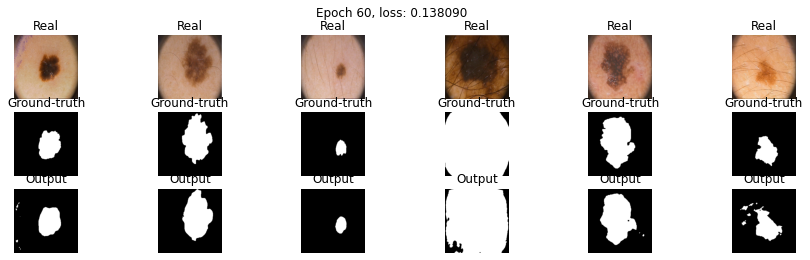

In [130]:
history_unet2_bce = train(data_tr, data_val, unet2_bce, optim, bce_loss, max_epochs, batch_size)

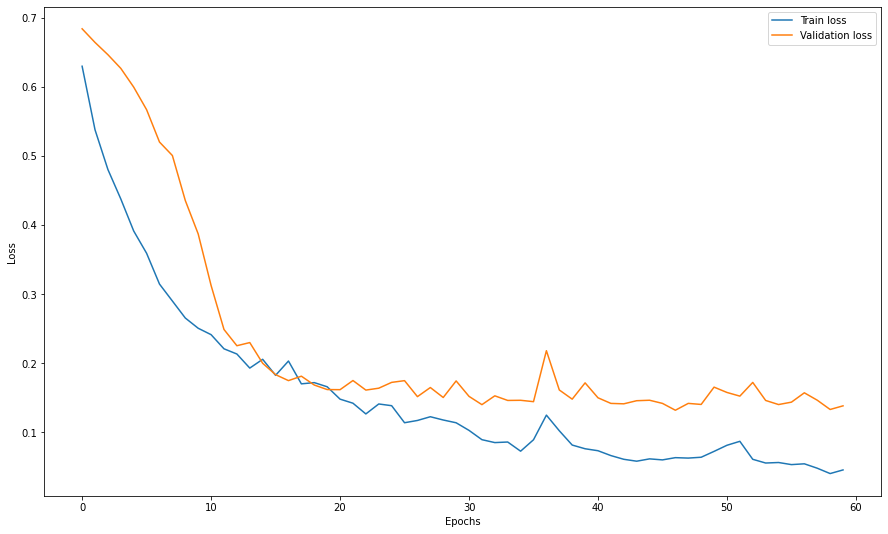

In [131]:
plot_loss(history_unet2_bce)

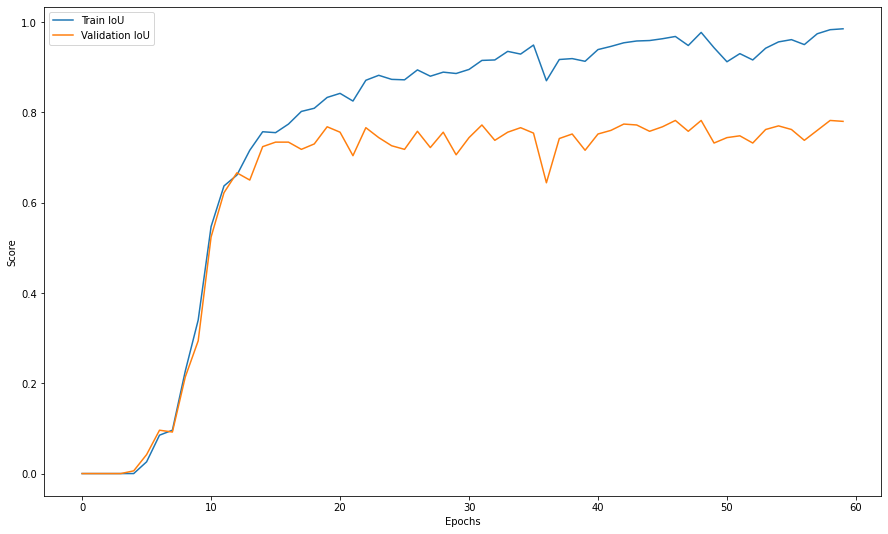

In [132]:
plot_metrics(history_unet2_bce)

In [134]:
score_unet2_bce = score_model(unet2_bce, iou_pytorch, data_ts)
test_scores.append(score_unet2_bce)
score_unet2_bce

Scoring:   0%|          | 0/2 [00:00<?, ?it/s]

0.7439999878406525

In [135]:
#save_model(f"/content/unet2_bce_{max_epochs}.tar", unet2_bce, optim, bce_loss, max_epochs, history_unet2_bce)

In [136]:
save_history("/content/history_unet2_bce.pickle", history_unet2_bce)

In [137]:
unet2_bce = unet2_bce.to("cpu")
del unet2_bce
torch.cuda.empty_cache()

### UNet modified Dice loss training

In [138]:
unet2_dice = UNet2().to(device)

In [139]:
summary(unet2_dice, (batch_size, 3, 256, 256))

Layer (type:depth-idx)                   Output Shape              Param #
UNet2                                    --                        --
├─Sequential: 1-1                        [25, 32, 256, 256]        --
│    └─Conv2d: 2-1                       [25, 32, 256, 256]        896
│    └─BatchNorm2d: 2-2                  [25, 32, 256, 256]        64
│    └─ReLU: 2-3                         [25, 32, 256, 256]        --
│    └─Conv2d: 2-4                       [25, 32, 256, 256]        9,248
│    └─BatchNorm2d: 2-5                  [25, 32, 256, 256]        64
│    └─ReLU: 2-6                         [25, 32, 256, 256]        --
├─Conv2d: 1-2                            [25, 32, 128, 128]        4,128
├─Sequential: 1-3                        [25, 64, 128, 128]        --
│    └─Conv2d: 2-7                       [25, 64, 128, 128]        18,496
│    └─BatchNorm2d: 2-8                  [25, 64, 128, 128]        128
│    └─ReLU: 2-9                         [25, 64, 128, 128]        --
│  

In [ ]:
!nvidia-smi

Fri Dec 10 17:06:51 2021       
+-----------------------------------------------------------------------------+
| NVIDIA-SMI 495.44       Driver Version: 460.32.03    CUDA Version: 11.2     |
|-------------------------------+----------------------+----------------------+
| GPU  Name        Persistence-M| Bus-Id        Disp.A | Volatile Uncorr. ECC |
| Fan  Temp  Perf  Pwr:Usage/Cap|         Memory-Usage | GPU-Util  Compute M. |
|                               |                      |               MIG M. |
|===============================+======================+======================|
|   0  Tesla K80           Off  | 00000000:00:04.0 Off |                    0 |
| N/A   55C    P0    61W / 149W |   4228MiB / 11441MiB |      0%      Default |
|                               |                      |                  N/A |
+-------------------------------+----------------------+----------------------+
                                                                               
+-------

In [140]:
optim = torch.optim.AdamW(unet2_dice.parameters(), lr=1e-4)


Epoch 060 train_loss: 0.0337   val_loss 0.1059 train_iou 0.9410 val_iou 0.7380


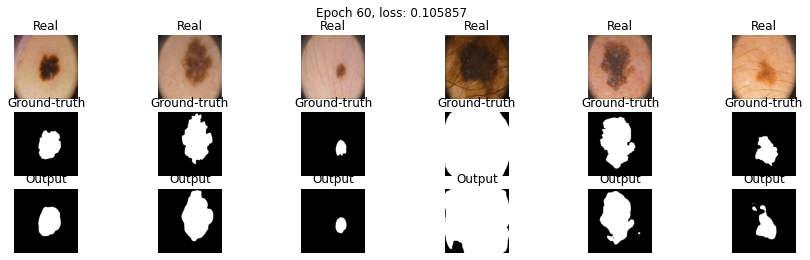

In [141]:
history_unet2_dice = train(data_tr, data_val, unet2_dice, optim, dice_loss, max_epochs, batch_size)

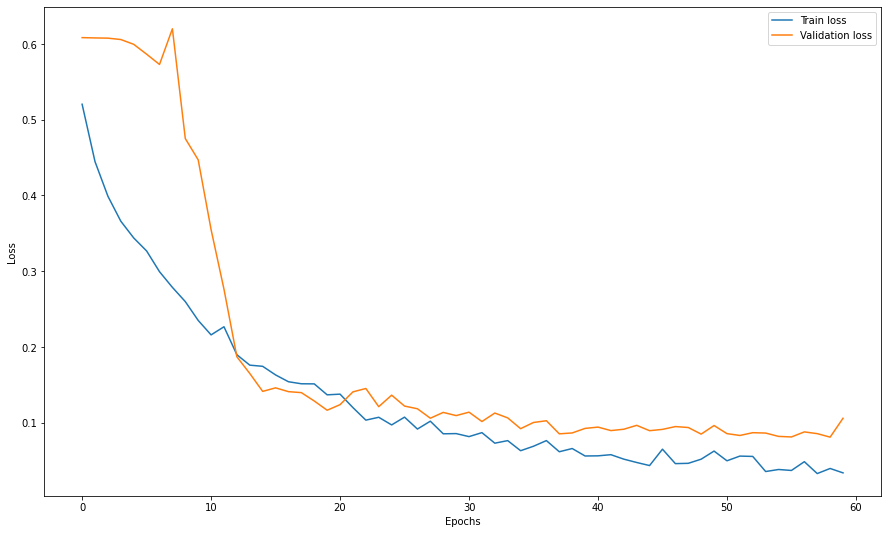

In [142]:
plot_loss(history_unet2_dice)

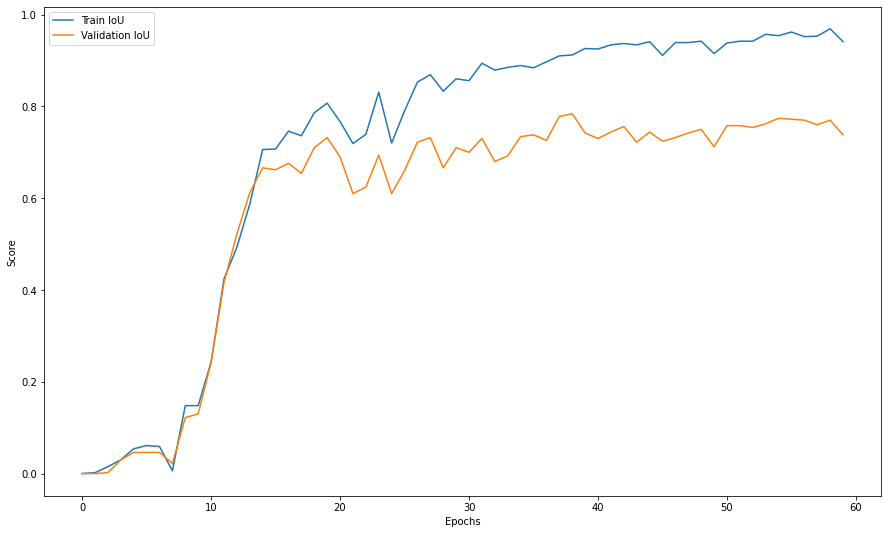

In [143]:
plot_metrics(history_unet2_dice)

In [144]:
score_unet2_dice = score_model(unet2_dice, iou_pytorch, data_ts)
test_scores.append(score_unet2_dice)
score_unet2_dice

Scoring:   0%|          | 0/2 [00:00<?, ?it/s]

0.706000030040741

In [145]:
#save_model(f"/content/unet2_dice_{max_epochs}.tar", unet2_dice, optim, dice_loss, max_epochs, history_unet2_dice)

In [146]:
save_history("/content/history_unet2_dice.pickle", history_unet2_dice)

In [147]:
unet2_dice = unet2_dice.to("cpu")
del unet2_dice
torch.cuda.empty_cache()

### UNet modified Focal loss training

In [148]:
unet2_focal = UNet2().to(device)

In [149]:
summary(unet2_focal, (batch_size, 3, 256, 256))

Layer (type:depth-idx)                   Output Shape              Param #
UNet2                                    --                        --
├─Sequential: 1-1                        [25, 32, 256, 256]        --
│    └─Conv2d: 2-1                       [25, 32, 256, 256]        896
│    └─BatchNorm2d: 2-2                  [25, 32, 256, 256]        64
│    └─ReLU: 2-3                         [25, 32, 256, 256]        --
│    └─Conv2d: 2-4                       [25, 32, 256, 256]        9,248
│    └─BatchNorm2d: 2-5                  [25, 32, 256, 256]        64
│    └─ReLU: 2-6                         [25, 32, 256, 256]        --
├─Conv2d: 1-2                            [25, 32, 128, 128]        4,128
├─Sequential: 1-3                        [25, 64, 128, 128]        --
│    └─Conv2d: 2-7                       [25, 64, 128, 128]        18,496
│    └─BatchNorm2d: 2-8                  [25, 64, 128, 128]        128
│    └─ReLU: 2-9                         [25, 64, 128, 128]        --
│  

In [150]:
!nvidia-smi

Fri Dec 10 23:57:02 2021       
+-----------------------------------------------------------------------------+
| NVIDIA-SMI 495.44       Driver Version: 460.32.03    CUDA Version: 11.2     |
|-------------------------------+----------------------+----------------------+
| GPU  Name        Persistence-M| Bus-Id        Disp.A | Volatile Uncorr. ECC |
| Fan  Temp  Perf  Pwr:Usage/Cap|         Memory-Usage | GPU-Util  Compute M. |
|                               |                      |               MIG M. |
|===============================+======================+======================|
|   0  Tesla K80           Off  | 00000000:00:04.0 Off |                    0 |
| N/A   72C    P0    77W / 149W |   4804MiB / 11441MiB |      0%      Default |
|                               |                      |                  N/A |
+-------------------------------+----------------------+----------------------+
                                                                               
+-------

In [151]:
optim = torch.optim.AdamW(unet2_focal.parameters(), lr=1e-4)


Epoch 060 train_loss: 0.0102   val_loss 0.0470 train_iou 0.9860 val_iou 0.7540


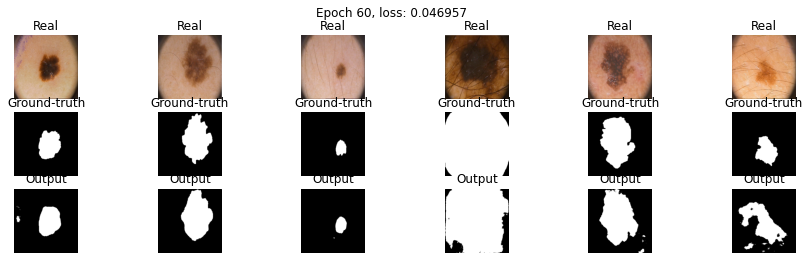

In [152]:
history_unet2_focal = train(data_tr, data_val, unet2_focal, optim, focal_loss, max_epochs, batch_size)

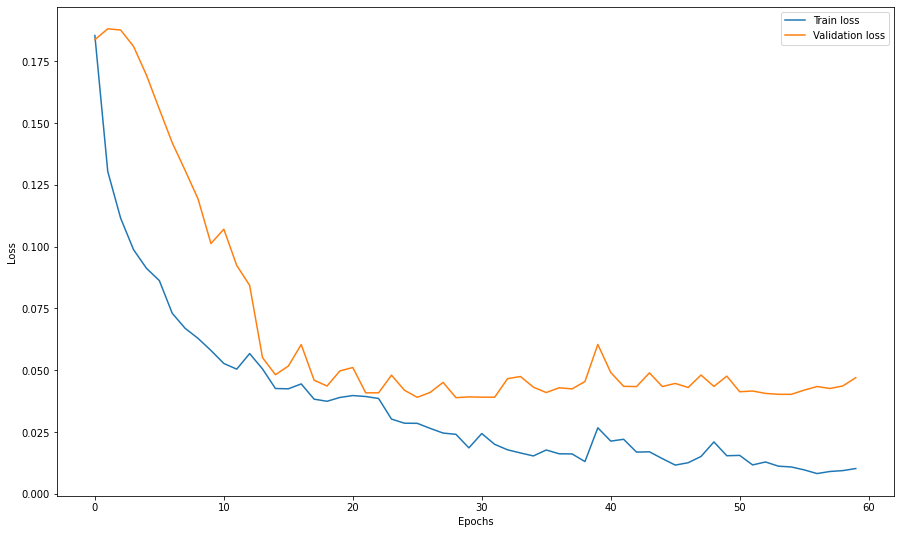

In [153]:
plot_loss(history_unet2_focal)

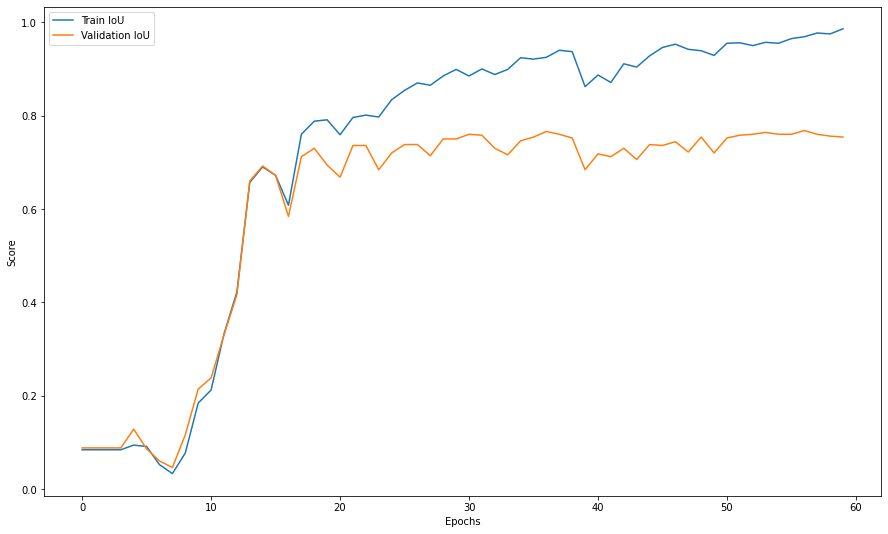

In [154]:
plot_metrics(history_unet2_focal)

In [155]:
score_unet2_focal = score_model(unet2_focal, iou_pytorch, data_ts)
test_scores.append(score_unet2_focal)
score_unet2_focal

Scoring:   0%|          | 0/2 [00:00<?, ?it/s]

0.7359999716281891

In [156]:
#save_model(f"/content/unet2_focal_{max_epochs}.tar", unet2_focal, optim, focal_loss, max_epochs, history_unet2_focal)

In [157]:
save_history("/content/history_unet2_focal.pickle", history_unet2_focal)

In [158]:
unet2_focal = unet2_focal.to("cpu")
del unet2_focal
torch.cuda.empty_cache()

### UNet modified Structural Similarity loss training

In [159]:
unet2_ssl = UNet2().to(device)

In [160]:
summary(unet2_ssl, (batch_size, 3, 256, 256))

Layer (type:depth-idx)                   Output Shape              Param #
UNet2                                    --                        --
├─Sequential: 1-1                        [25, 32, 256, 256]        --
│    └─Conv2d: 2-1                       [25, 32, 256, 256]        896
│    └─BatchNorm2d: 2-2                  [25, 32, 256, 256]        64
│    └─ReLU: 2-3                         [25, 32, 256, 256]        --
│    └─Conv2d: 2-4                       [25, 32, 256, 256]        9,248
│    └─BatchNorm2d: 2-5                  [25, 32, 256, 256]        64
│    └─ReLU: 2-6                         [25, 32, 256, 256]        --
├─Conv2d: 1-2                            [25, 32, 128, 128]        4,128
├─Sequential: 1-3                        [25, 64, 128, 128]        --
│    └─Conv2d: 2-7                       [25, 64, 128, 128]        18,496
│    └─BatchNorm2d: 2-8                  [25, 64, 128, 128]        128
│    └─ReLU: 2-9                         [25, 64, 128, 128]        --
│  

In [161]:
!nvidia-smi

Sat Dec 11 00:14:16 2021       
+-----------------------------------------------------------------------------+
| NVIDIA-SMI 495.44       Driver Version: 460.32.03    CUDA Version: 11.2     |
|-------------------------------+----------------------+----------------------+
| GPU  Name        Persistence-M| Bus-Id        Disp.A | Volatile Uncorr. ECC |
| Fan  Temp  Perf  Pwr:Usage/Cap|         Memory-Usage | GPU-Util  Compute M. |
|                               |                      |               MIG M. |
|===============================+======================+======================|
|   0  Tesla K80           Off  | 00000000:00:04.0 Off |                    0 |
| N/A   73C    P0   133W / 149W |   4806MiB / 11441MiB |     73%      Default |
|                               |                      |                  N/A |
+-------------------------------+----------------------+----------------------+
                                                                               
+-------

In [162]:
optim = torch.optim.AdamW(unet2_ssl.parameters(), lr=1e-4)


Epoch 060 train_loss: 0.0586   val_loss 0.1564 train_iou 0.9610 val_iou 0.7480


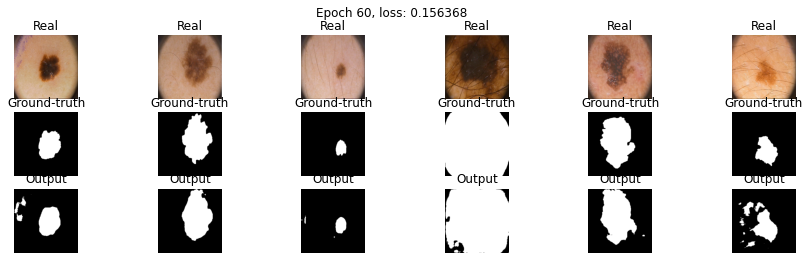

In [163]:
history_unet2_ssl = train(data_tr, data_val, unet2_ssl, optim, ssl_loss, max_epochs, batch_size)

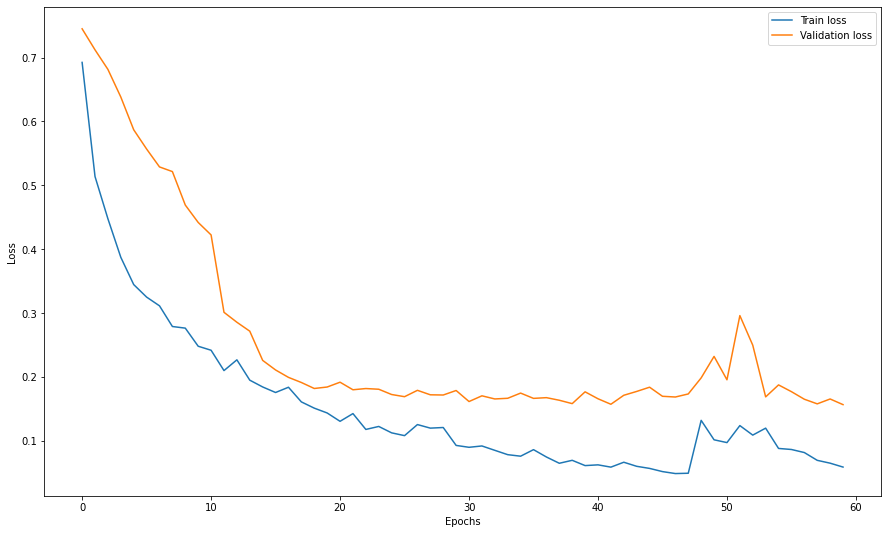

In [164]:
plot_loss(history_unet2_ssl)

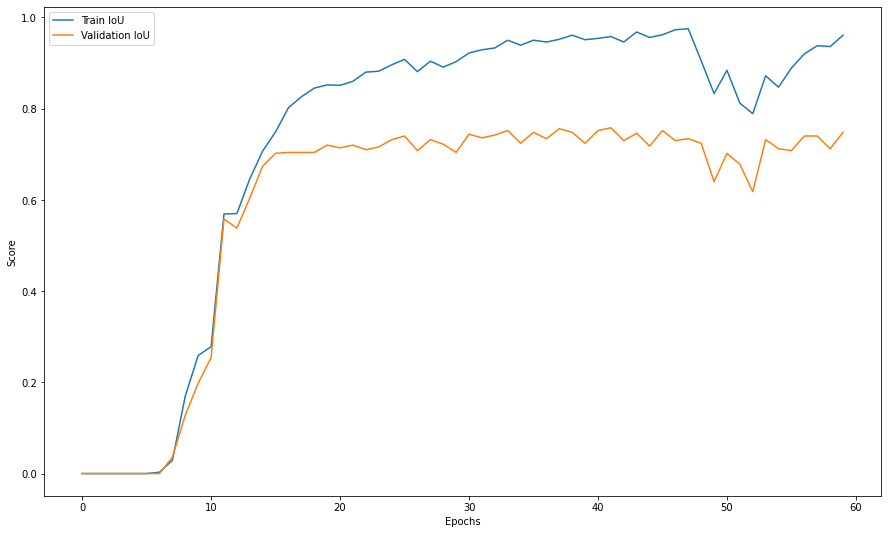

In [165]:
plot_metrics(history_unet2_ssl)

In [166]:
score_unet2_ssl = score_model(unet2_ssl, iou_pytorch, data_ts)
test_scores.append(score_unet2_ssl)
score_unet2_ssl

Scoring:   0%|          | 0/2 [00:00<?, ?it/s]

0.7540000081062317

In [167]:
#save_model(f"/content/unet2_ssl_{max_epochs}.tar", unet2_ssl, optim, ssl_loss, max_epochs, history_unet2_ssl)

In [168]:
save_history("/content/history_unet2_ssl.pickle", history_unet2_ssl)

In [169]:
unet2_ssl = unet2_ssl.to("cpu")
del unet2_ssl
torch.cuda.empty_cache()

Сделайте вывод, какая из моделей лучше

# Отчет (6 баллов): 
Ниже предлагается написать отчет о проделанно работе и построить графики для лоссов, метрик на валидации и тесте. 
Если вы пропустили какую-то часть в задании выше, то вы все равно можете получить основную часть баллов в отчете, если правильно зададите проверяемые вами гипотезы.


Аккуратно сравните модели между собой и соберите наилучшую архитектуру. Проверьте каждую модель с различными лоссами. Мы не ограничиваем вас в формате отчета, но проверяющий должен отчетливо понять для чего построен каждый график, какие выводы вы из него сделали и какой общий вывод можно сделать на основании данных моделей. Если вы захотите добавить что-то еще, чтобы увеличить шансы получения максимального балла, то добавляйте отдельное сравнение.

Дополнительные комментарии: 

Пусть у вас есть N обученных моделей.
- Является ли отчетом N графиков с 1 линей? Да, но очень низкокачественным, потому что проверяющий не сможет сам сравнить их.

- Является ли отчетом 1 график с N линиями? Да, но скорее всего таким образом вы отразили лишь один эффект. Этого мало, чтобы сделать досточно суждений по поводу вашей работа.

- Я проверял метрики на трейне, и привел в результате таблицу с N числами, что не так? ключейвой момент тут, что вы измеряли на трейне ваши метрики, уверены ли вы, что заивисмости останутся такими же на отложенной выборке?

- Я сделал отчет содержащий график лоссов и метрик, и у меня нет ошибок в основной части, но за отчет не стоит максимум, почему? Естестественно максимум баллов за отчет можно получить не за 2 графика (даже при условии их полной правильности). Проверяющий хочет видеть больше сравнений моделей, чем метрики и лоссы (особенно, если они на трейне).

Советы: попробуйте правильно поставить вопрос на который вы себе отвечаете и продемонстрировать таблицу/график, помогающий проверяющему увидеть ответ на этот вопрос. Пример: Ваня хочет узнать, с каким из 4-х лоссов модель (например, U-Net) имеет наилучшее качество. Что нужно сделать Ване? Обучить 4 одинаковых модели с разными лосс функциями. И измерить итогововое качество. Продемонстрировать результаты своих измерений и итоговый вывод. (warning: конечно же, это не идеально ответит на наш вопрос, так как мы не учитываем в экспериментах возможные различные типы ошибок, но для первого приближения этого вполне достаточно).

Примерное время на подготовку отчета 1 час, он содержит сравнеение метрик, график лоссов, выбор лучших моделей из нескольких кластеров и выбор просто лучшей модели, небольшой вывод по всему дз, возможно сравнение результирующих сегментаций, времени или числа параметров модели, проявляйте креативность.

In [170]:
def plot_comparison_history(*args, mode = "loss", model_arch = "SegNet"):
  bce, dice, focal, ssl = zip(args)
  bce, dice, focal, ssl = bce[0], dice[0], focal[0], ssl[0]
  if mode == "iou" or mode == "metric":
    mode = "IoU"
  if mode == "loss":
    tr_bce, _, val_bce, _, _ = zip(*bce)
    tr_dice, _, val_dice, _, _ = zip(*dice)
    tr_focal, _, val_focal, _, _ = zip(*focal)
    tr_ssl, _, val_ssl, _, _ = zip(*ssl)
  else:
    _, tr_bce, _, val_bce, _ = zip(*bce)
    _, tr_dice, _, val_dice, _ = zip(*dice)
    _, tr_focal, _, val_focal, _ = zip(*focal)
    _, tr_ssl, _, val_ssl, _ = zip(*ssl)
  fig, ax = plt.subplots(2, 2, figsize=(15, 10))
  ax[0][0].plot(tr_bce, label=f"Train {mode}")
  ax[0][0].plot(val_bce, label=f"Validation {mode}")
  ax[0][0].set_title(f"{model_arch} train and validation {mode} with BCE loss")

  ax[0][1].plot(tr_dice, label=f"Train {mode}")
  ax[0][1].plot(val_dice, label=f"Validation {mode}")
  ax[0][1].set_title(f"{model_arch} train and validation {mode} with Dice loss")

  ax[1][0].plot(tr_focal, label=f"Train {mode}")
  ax[1][0].plot(val_focal, label=f"Validation {mode}")
  ax[1][0].set_title(f"{model_arch} train and validation {mode} with Focal loss")

  ax[1][1].plot(tr_ssl, label=f"Train {mode}")
  ax[1][1].plot(val_ssl, label=f"Validation {mode}")
  ax[1][1].set_title(f"{model_arch} train and validation {mode} with Structural Similarity loss")

  plt.legend()
  plt.show()

In [5]:
def plot_bar_сomparisons(*args, mode="metric"):
  if mode == "metric":
    mode = "Test set IoU"
  else:
    mode = "Training time"
  fig = plt.figure(figsize=(20, 10))
  ax = fig.add_axes([0, 0, 1, 1])
  labels = ["BCE SegNet", "Dice SegNet", "Focal SegNet", "SSL SegNet",
            "BCE UNet", "Dice UNet", "Focal UNet", "SSL UNet",
            "BCE UNet modified", "Dice UNet modified", "Focal UNet modified", "SSL UNet modified"]
  ax.bar(labels, args)
  ax.set_ylabel(f"{mode}")
  ax.set_title(f"{mode}s for all models and losses")
  plt.show()

Начнём сравнение моделей

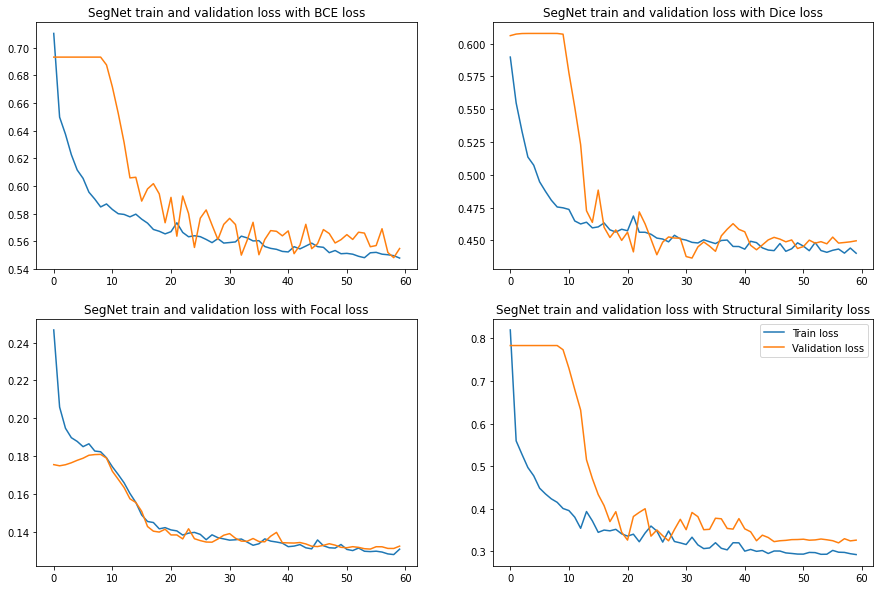

In [173]:
plot_comparison_history(history_segnet_bce, history_segnet_dice, history_segnet_focal, history_segnet_ssl)

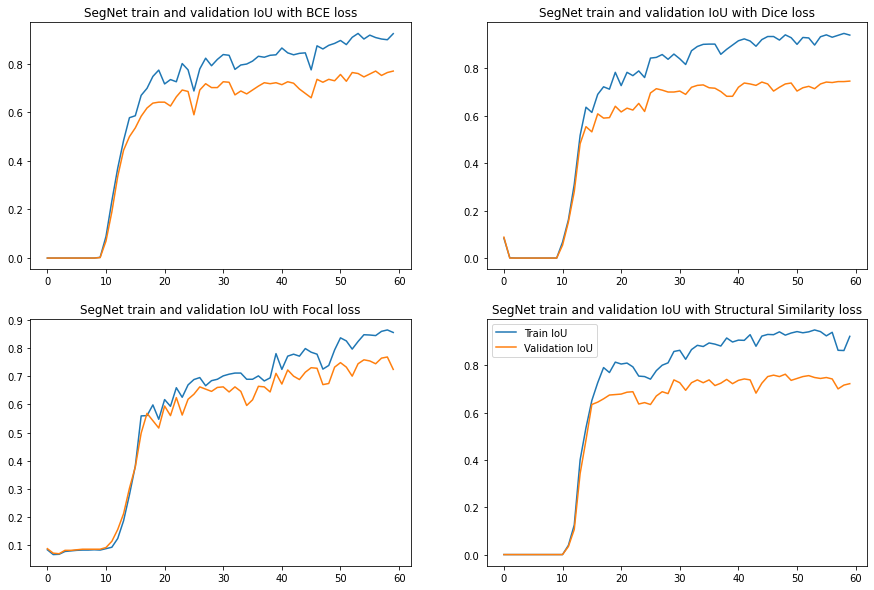

In [174]:
plot_comparison_history(history_segnet_bce, history_segnet_dice, history_segnet_focal, history_segnet_ssl, mode="metric")

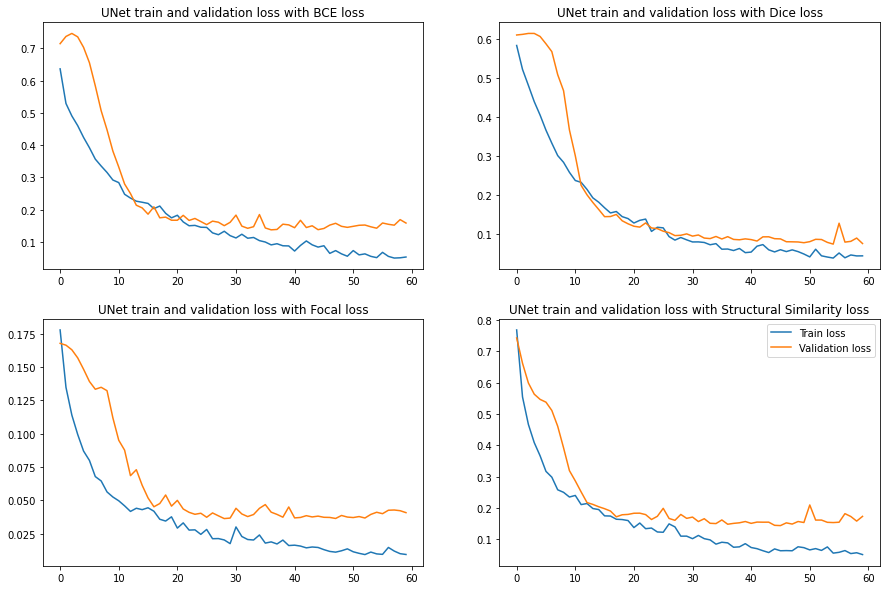

In [175]:
plot_comparison_history(history_unet_bce, history_unet_dice, history_unet_focal, history_unet_ssl, model_arch="UNet")

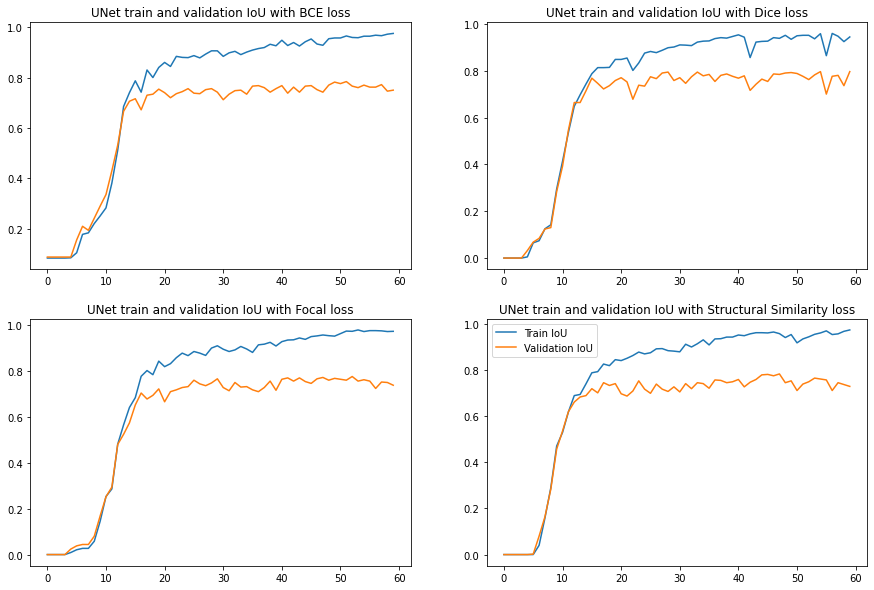

In [176]:
plot_comparison_history(history_unet_bce, history_unet_dice, history_unet_focal, history_unet_ssl, mode="metric", model_arch="UNet")

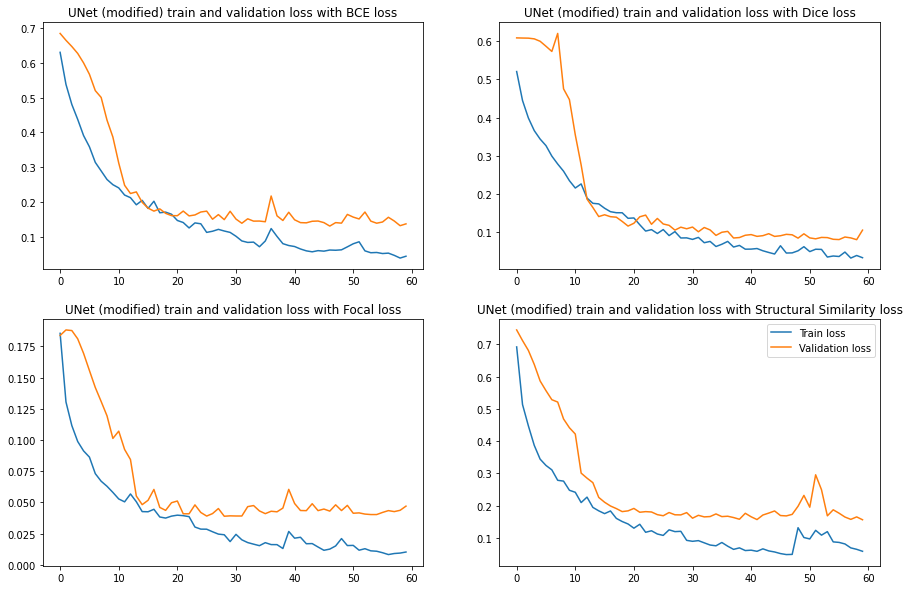

In [177]:
plot_comparison_history(history_unet2_bce, history_unet2_dice, history_unet2_focal, history_unet2_ssl, model_arch="UNet (modified)")

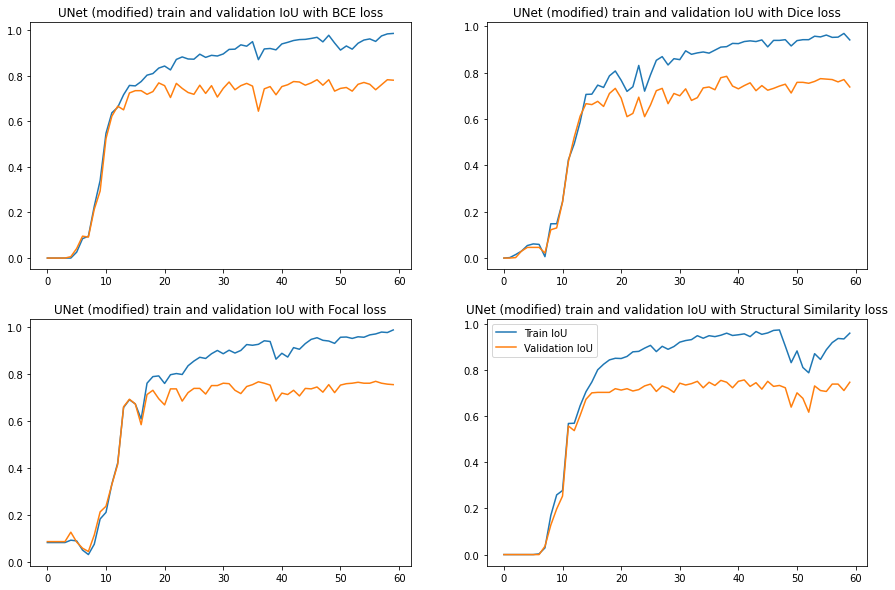

In [178]:
plot_comparison_history(history_unet2_bce, history_unet2_dice, history_unet2_focal, history_unet2_ssl, mode="metric", model_arch="UNet (modified)")

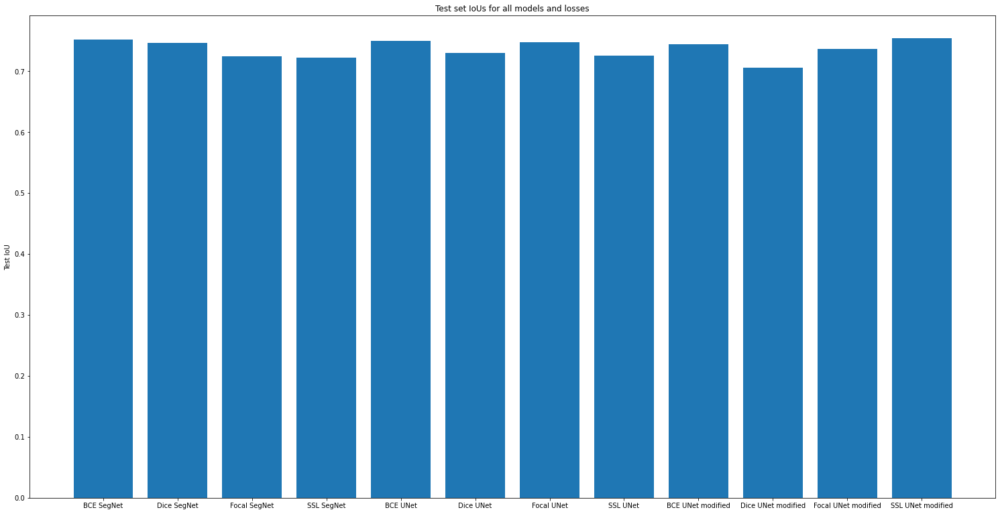

In [179]:
plot_bar_comparisons(*test_scores)